# Import

In [1]:
import json
import itertools

import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import pandas as pd
import seaborn as sns

from matplotlib import rcParams
rcParams['figure.figsize'] = 8, 8

# Function declaration

In [2]:
def save_fig(fig, name):
    fig.savefig("./graphs/" + name + ".pdf", format="pdf")

In [3]:
def fix_status(df_line):
    if df_line.status != "UNKNOWN":
        return df_line.status

    if df_line.objectives != {}:
        return "SATISFIABLE"

    return df_line.status

In [4]:
def get_optimal_solution(df_line):
    if df_line.status != "OPTIMAL_SOLUTION":
        return None

    return min(df_line.objectives.values())

Borda counting

|     s1 \ s2 | satisfied | unsatisfied |     unkown | optimized |
|-------------|-----------|-------------|------------|-----------|
|   satisfied | o, timing |         bug |        s_1 |       s_2 |
| unsatisfied |       bug |      timing |        s_1 |       bug |
|      unkown |       s_2 |         s_2 |        0-0 |       s_2 |
|   optimized |       s_1 |         bug |        s_1 |    timing |

where
- s_x means give one point to solver x and zero to the other solver
- o mean look at the objective value. If one solver gives a better answer, that
  solver wins one point and the other zero. If both are equals, look at the
  times
- bug means one of the two solver contains a bug
- timing mean look directly at the times
- 0-0 means that each solver gets zero points

In [5]:
def score(t1, t2):
    if t1 == 0 and t2 == 0:
        return (0.5, 0.5)
    else:
        return (
            t2 / (t1 + t2),
            t1 / (t1 + t2),
        )

def borda_count(x):
    try:
        model1 = x.iloc[0]
        model2 = x.iloc[1]

        status1 = model1.status
        status2 = model2.status

        obj1 = min(model1.objectives.values(), default=None)
        obj2 = min(model2.objectives.values(), default=None)

        t1 = int(model1.solve_time)
        t2 = int(model2.solve_time)
    except:
        print(x)

    if status1 == "Optimal solution":
        if status2 == "Optimal solution":
            if obj1 == obj2:
                return score(t1, t2)
            else:
                print("ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT")
        elif status2 == "Unsatisfiable":
            print("ERROR: ONE SOLVER REACHED THE OPTIMAL SOLUTION BUT THE OTHER ONE SAY UNSAT")
        else:
            return (1, 0)
    elif status1 == "Unknown":
        if status2 == "Unknown":
            return (0, 0)
        else:
            return (0, 1)
    elif status1 == "Unsatisfiable":
        if status2 == "Satisfiable" or status2 == "Optimal solution":
            print("ERROR: ONE SOLVER REACHED UNSAT BUT THE OTHER ONE SAY SAT/OPTIMAL")
        elif status2 == "Unknown":
            return (1, 0)
        else:
            return score(t1, t2)
    elif status1 == "Satisfiable":
        if status2 == "Unknown":
            return (1, 0)
        elif status2 == "Optimal solution":
            return (0, 1)
        elif status2 == "Satisfiable":
            if obj1 > obj2: # Minimization problem
                return (0, 1)
            elif obj1 < obj2:
                return (1, 0)
            else:
                return score(t1, t2)
        else:
            print("ERROR: ONE SOLVER REACHED SAT BUT THE OTHER ONE SAY UNSAT")

    # Exit results for errors
    return (0, 0)


# DataFrame import

In [6]:
with open("results/freeda-vs-zephyrus-32x32x3.json", "r") as f:
    results = json.load(f)

dfs = []
for k, v in results.items():
    x = pd.DataFrame(v).assign(**{
        "solver" : k
    })

    # Add test features
    test_feature = pd.DataFrame(
        x.problem.apply(lambda s : s.split("/")[-1][:-4].split("_")).tolist(),
        columns=["components", "flavours", "nodes", "resources", "comps_topology", "infra_topology", "test"]
    ).assign(**{
        "components" : lambda df : df.components.apply(lambda x : int(x[1:])),
        "flavours": 1, # lambda df : df.flavours.apply(lambda x : int(x[1:])),
        "nodes" : lambda df : df.nodes.apply(lambda x : int(x[1:])),
        "resources" : 1, # lambda df : df.resources.apply(lambda x : int(x[1:])),
        "comps_topology" : lambda df : df.comps_topology.apply(lambda x : x[1:].upper()),
        "infra_topology" : lambda df : df.infra_topology.apply(lambda x : x[1:].upper()),
        "test" : lambda df : df.test.apply(lambda x : int(x))
    }).assign(**{
        "model": x.problem.apply(lambda s : s.split("/")[-2].upper()).tolist(),
    })

    dfs.append(
        pd.merge(
            left=x,
            right=test_feature,
            right_index=True,
            left_index=True,
        )
    )

df = pd.concat(dfs).rename(columns={"model_y" : "model"}).assign(**{
    # Corrections for unkown status codes
    "solve_time" : lambda df : df.apply(
        lambda x :
            300
            if "UNKNOWN" in x["status"]
            else x.solve_time - x.flat_time,
        axis=1),
    "status" : lambda df : df.apply(
        lambda x : fix_status(x),
    axis=1),
}).replace({ # Rename some stuff
    "cpsatlp": "OR-Tools",
    "gecode": "Gecode",
    "highs": "Highs",
    "chuffed": "Chuffed",
    "BARABASI": "small-world",
    "ERDOS": "random",
    "LADDER": "ladder",
    "WHEEL": "wheel",
    "PATH": "pipeline",
    "COMPLETE": "complete",
    "SATISFIABLE": "Satisfiable",
    "OPTIMAL_SOLUTION": "Optimal solution",
    "UNSATISFIABLE": "Unsatisfiable",
    "UNKNOWN": "Unknown",
    "ZEPHYRUS": "Zephyrus"
}).assign(optimal_solution=lambda df : df.apply(
    lambda x : min(x.objectives.values()) if "Optimal solution" in x.status else None, axis=1
)).drop(columns=["problem"]).reset_index(drop=True)
df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
0,Optimal solution,0.550,0.024,{'0.574': 0},Chuffed,4,1,3,1,small-world,complete,0,FREEDA,0.0
1,Optimal solution,0.519,0.025,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
2,Optimal solution,0.507,0.032,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
3,Optimal solution,0.150,0.021,"{'0.17': 11, '0.171': 2}",Chuffed,4,1,3,1,small-world,complete,0,Zephyrus,2.0
4,Optimal solution,0.153,0.020,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46939,Optimal solution,1.024,0.555,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46940,Optimal solution,1.023,0.801,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46941,Optimal solution,21.428,25.530,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46942,Optimal solution,21.559,22.839,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


# Clean up

In [7]:
df = df.query("infra_topology == 'complete'")

In [8]:
df = df.query("components <= 32").query("nodes <= 32")

In [9]:
df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
0,Optimal solution,0.550,0.024,{'0.574': 0},Chuffed,4,1,3,1,small-world,complete,0,FREEDA,0.0
1,Optimal solution,0.519,0.025,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
2,Optimal solution,0.507,0.032,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
3,Optimal solution,0.150,0.021,"{'0.17': 11, '0.171': 2}",Chuffed,4,1,3,1,small-world,complete,0,Zephyrus,2.0
4,Optimal solution,0.153,0.020,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46939,Optimal solution,1.024,0.555,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46940,Optimal solution,1.023,0.801,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46941,Optimal solution,21.428,25.530,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46942,Optimal solution,21.559,22.839,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


In [10]:
df.groupby(["components", "nodes", "comps_topology", "test"]).count()

status  flat_time  solve_time  \
components nodes comps_topology test                                  
4          3     pipeline       0          6          6           6   
                                1          6          6           6   
                                2          6          6           6   
                 random         0          6          6           6   
                                1          6          6           6   
...                                      ...        ...         ...   
32         32    random         1          6          6           6   
                                2          6          6           6   
                 small-world    0          6          6           6   
                                1          6          6           6   
                                2          6          6           6   

                                      objectives  solver  flavours  resources  \
components nodes comps_topology test                                            
4          3     pipeline       0              6       6         6          6   
                                1              6       6         6          6   
                                2              6       6         6          6   
                 random         0              6       6         6          6   
                                1              6       6         6          6   
...                                          ...     ...       ...        ...   
32         32    random         1              6       6         6          6   
                                2              6       6         6          6   
                 small-world    0              6       6         6          6   
                                1              6       6         6          6   
                                2              6       6         6          6   

                                      infra_topology  model  optimal_solution  
components nodes comps_topology test                                           
4          3     pipeline       0                  6      6                 6  
                                1                  6      6                 6  
                                2                  6      6                 6  
                 random         0                  6      6                 6  
                                1                  6      6                 6  
...                                              ...    ...               ...  
32         32    random         1                  6      6                 4  
                                2                  6      6                 4  
                 small-world    0                  6      6                 4  
                                1                  6      6                 4  
                                2                  6      6                 5  

[7824 rows x 10 columns]

In [11]:
check = (df
    .reset_index()
    .rename(columns={"index": "drop_index"})
    .drop(columns=["flavours", "resources", "flat_time", "solve_time", "infra_topology", "objectives"])
    .groupby(["components", "nodes", "comps_topology", "test"])
)

different_objectives = []
not_all_solvers = []
for _, group in check:
    if len(group) != 6: # 6 = 3 solvers x 2 models
        not_all_solvers.append(group)
        continue

    a = group.status.value_counts().reset_index()
    if len(a.query("status == 'Unsatisfiable'")) > 0 and len(a.query("status != 'Unsatisfiable'")) > 0:
            different_objectives.append(group)

In [12]:
pd.concat(not_all_solvers).drop_duplicates() if len(not_all_solvers) > 0 else pd.DataFrame()

""


In [13]:
pd.concat(different_objectives).drop_duplicates() if len(different_objectives) > 0 else pd.DataFrame()

""


In [14]:
df = (df
    .drop(index=
        pd.concat(not_all_solvers).drop_index
        if len(not_all_solvers) > 0
        else pd.DataFrame().index
    ).drop(index=
        pd.concat(different_objectives).drop_index
        if len(different_objectives) > 0
        else pd.DataFrame().index
    )
)
df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
0,Optimal solution,0.550,0.024,{'0.574': 0},Chuffed,4,1,3,1,small-world,complete,0,FREEDA,0.0
1,Optimal solution,0.519,0.025,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
2,Optimal solution,0.507,0.032,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
3,Optimal solution,0.150,0.021,"{'0.17': 11, '0.171': 2}",Chuffed,4,1,3,1,small-world,complete,0,Zephyrus,2.0
4,Optimal solution,0.153,0.020,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46939,Optimal solution,1.024,0.555,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46940,Optimal solution,1.023,0.801,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46941,Optimal solution,21.428,25.530,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46942,Optimal solution,21.559,22.839,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


In [15]:
models = df.model.unique().tolist()
solvers = df.solver.unique()
component_topologies = df.comps_topology.unique()
infrastructure_topologies = df.infra_topology.unique()
tests = df.test.unique()
alpha = 1.0 / len(tests)
statuses = df.status.unique()

In [16]:
color = {
    "Chuffed" : "red",
    "OR-Tools": "orange",
    "Gecode" : "#1f77b4",
    "Highs" : "green"
}

marker = {
    "Chuffed" : ".",
    "OR-Tools": "_",
    "Gecode" : "x",
    "Highs" : "2"
}

In [17]:
df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
0,Optimal solution,0.550,0.024,{'0.574': 0},Chuffed,4,1,3,1,small-world,complete,0,FREEDA,0.0
1,Optimal solution,0.519,0.025,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
2,Optimal solution,0.507,0.032,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
3,Optimal solution,0.150,0.021,"{'0.17': 11, '0.171': 2}",Chuffed,4,1,3,1,small-world,complete,0,Zephyrus,2.0
4,Optimal solution,0.153,0.020,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46939,Optimal solution,1.024,0.555,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46940,Optimal solution,1.023,0.801,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46941,Optimal solution,21.428,25.530,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46942,Optimal solution,21.559,22.839,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


In [18]:
# Remove istances where solvers are bugged

df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["model", "solver", "flavours", "resources", "flat_time", "infra_topology", "optimal_solution"])

combinations = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

different_results = []
for model_solver1, model_solver2 in combinations:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        if borda_count(group) == (0, 0):
            different_results.append(group)

ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERROR: BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT
ERRO

In [19]:
pd.concat(different_results)[["components", "nodes", "comps_topology", "test"]]

,components,nodes,comps_topology,test
0,4,3,small-world,0
3,4,3,small-world,0
24,4,4,random,0
27,4,4,random,0
18,4,4,small-world,0
...,...,...,...,...
46918,32,31,random,1
15640,32,32,random,1
46936,32,32,random,1
15634,32,32,small-world,1


In [20]:
df = df[
    ~(
        df.set_index(["components", "nodes", "comps_topology", "test"])
        .index
        .isin(
            pd.concat(different_results)
            [["components", "nodes", "comps_topology", "test"]]
            .drop_duplicates()
            .set_index(["components", "nodes", "comps_topology", "test"])
            .index
        )
    )
].reset_index(drop=True)

In [21]:
df.groupby(["components", "nodes", "comps_topology", "test"]).count()

status  flat_time  solve_time  \
components nodes comps_topology test                                  
4          3     pipeline       0          6          6           6   
                                1          6          6           6   
                                2          6          6           6   
                 random         0          6          6           6   
                                1          6          6           6   
...                                      ...        ...         ...   
32         32    pipeline       2          6          6           6   
                 random         0          6          6           6   
                                2          6          6           6   
                 small-world    0          6          6           6   
                                2          6          6           6   

                                      objectives  solver  flavours  resources  \
components nodes comps_topology test                                            
4          3     pipeline       0              6       6         6          6   
                                1              6       6         6          6   
                                2              6       6         6          6   
                 random         0              6       6         6          6   
                                1              6       6         6          6   
...                                          ...     ...       ...        ...   
32         32    pipeline       2              6       6         6          6   
                 random         0              6       6         6          6   
                                2              6       6         6          6   
                 small-world    0              6       6         6          6   
                                2              6       6         6          6   

                                      infra_topology  model  optimal_solution  
components nodes comps_topology test                                           
4          3     pipeline       0                  6      6                 6  
                                1                  6      6                 6  
                                2                  6      6                 6  
                 random         0                  6      6                 6  
                                1                  6      6                 6  
...                                              ...    ...               ...  
32         32    pipeline       2                  6      6                 6  
                 random         0                  6      6                 5  
                                2                  6      6                 4  
                 small-world    0                  6      6                 4  
                                2                  6      6                 5  

[7725 rows x 10 columns]

In [22]:
df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
0,Optimal solution,0.519,0.025,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
1,Optimal solution,0.507,0.032,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
2,Optimal solution,0.153,0.020,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
3,Optimal solution,0.148,0.018,"{'0.164': 5, '0.165': 2, '0.166': 1}",Chuffed,4,1,3,1,small-world,complete,2,Zephyrus,1.0
4,Optimal solution,0.581,0.027,"{'0.607': 6, '0.608': 2}",Chuffed,4,1,3,1,random,complete,0,FREEDA,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46345,Optimal solution,1.024,0.555,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46346,Optimal solution,1.023,0.801,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46347,Optimal solution,21.428,25.530,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46348,Optimal solution,21.559,22.839,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


# DataFrame Analysis

In [23]:
(
    #solvers *
    len(component_topologies)
    * len(list(range(4, 33)))
    * len(list(range(3, 33)))
    * len(list(range(1, 4)))
)

7830

In [24]:
df.status.unique()

array(['Optimal solution', 'Satisfiable', 'Unknown'], dtype=object)

In [25]:
df.status.value_counts(normalize=True)

status
Optimal solution    0.989622
Unknown             0.007789
Satisfiable         0.002589
Name: proportion, dtype: float64

In [26]:
df[["components", "status"]].groupby("components").value_counts()

components  status          
4           Optimal solution    1494
5           Optimal solution    1560
6           Optimal solution    1602
7           Optimal solution    1614
8           Optimal solution    1620
9           Optimal solution    1602
10          Optimal solution    1596
11          Optimal solution    1614
12          Optimal solution    1620
13          Optimal solution    1620
14          Optimal solution    1620
15          Optimal solution    1620
16          Optimal solution    1620
17          Optimal solution    1620
18          Optimal solution    1619
            Satisfiable            1
19          Optimal solution    1620
20          Optimal solution    1618
            Unknown                2
21          Optimal solution    1620
22          Optimal solution    1619
            Unknown                1
23          Optimal solution    1611
            Unknown                8
            Satisfiable            1
24          Optimal solution    1617
         

In [27]:
df[["nodes", "status"]].groupby("nodes").value_counts()

nodes  status          
3      Optimal solution    1541
       Unknown               13
4      Optimal solution    1529
       Unknown                7
5      Optimal solution    1535
                           ... 
31     Unknown               13
       Satisfiable            2
32     Optimal solution    1498
       Unknown               15
       Satisfiable            5
Name: count, Length: 88, dtype: int64

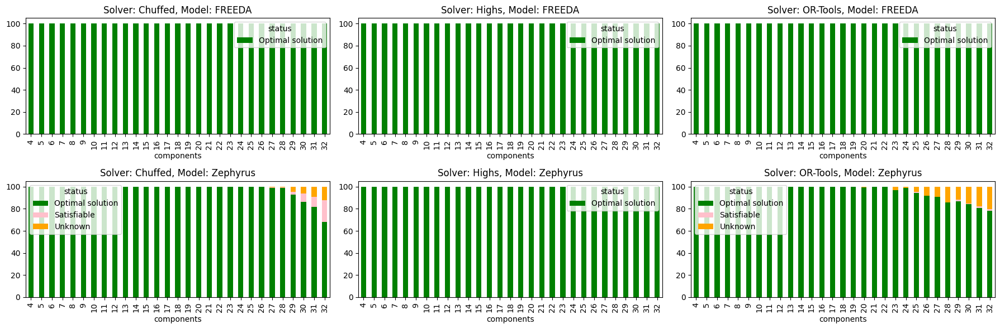

In [28]:
statuses = df.status.unique()

fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6)
)
norm = Normalize(vmin=0, vmax=100)
for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            [["components", "status"]]
            .groupby("components")
            .value_counts(normalize=True)
            * 100
        ).reset_index().pivot(
            index="components",
            columns="status",
            values="proportion"
        ).fillna(0)

        d.plot.bar(
            color={"Optimal solution": "green", "Unsatisfiable": "#1f77b4", "Unknown": "orange", "Satisfiable" : "pink"},
            stacked=True,
            ax=ax,
            title="Solver: " + solver + ", Model: " + model
        )

#fig.suptitle("Percentage of statuses")
fig.tight_layout()
plt.show()

In [29]:
pd.concat(
    [
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(),
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(normalize=True) * 100
    ],
    axis=1,
    keys=['counts', '%']
).reset_index()#.to_csv("./status_aggregated.csv", index=False)

,components,nodes,status,counts,%
0,4,3,Optimal solution,48,100.000000
1,4,4,Optimal solution,42,100.000000
2,4,5,Optimal solution,48,100.000000
3,4,6,Optimal solution,54,100.000000
4,4,7,Optimal solution,48,100.000000
...,...,...,...,...,...
1126,32,31,Unknown,5,10.416667
1127,32,31,Satisfiable,1,2.083333
1128,32,32,Optimal solution,36,85.714286
1129,32,32,Satisfiable,3,7.142857


<Axes: title={'center': 'Distribution of solve_time'}>

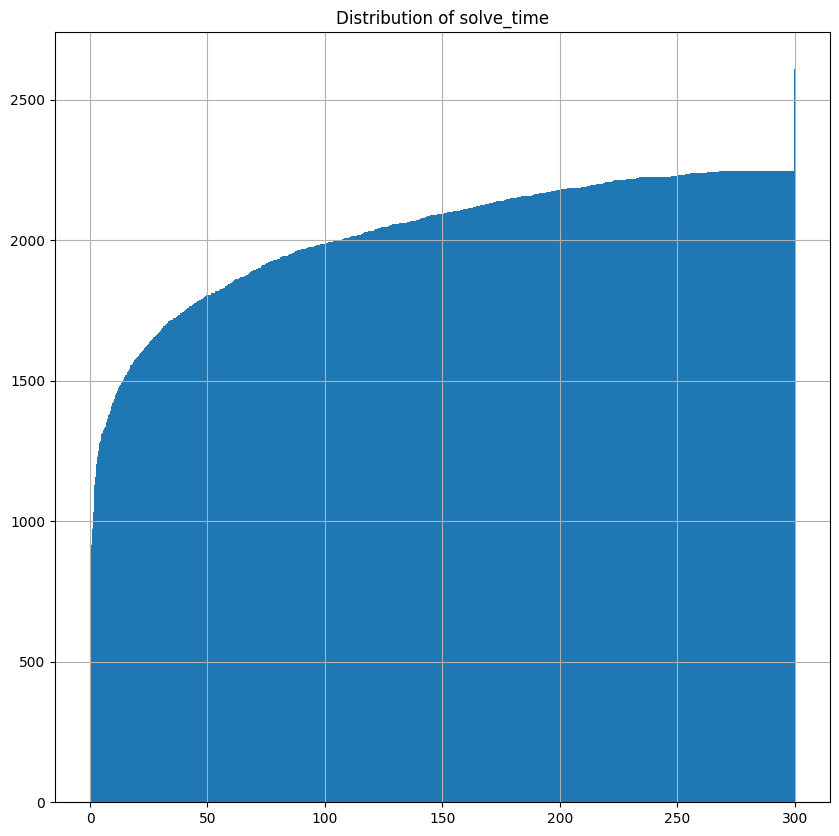

In [30]:
plt.figure(figsize=(10, 10))
plt.title("Distribution of solve_time")
vbs = df.sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

<Axes: title={'center': 'Distribution only for Optimal solutions'}>

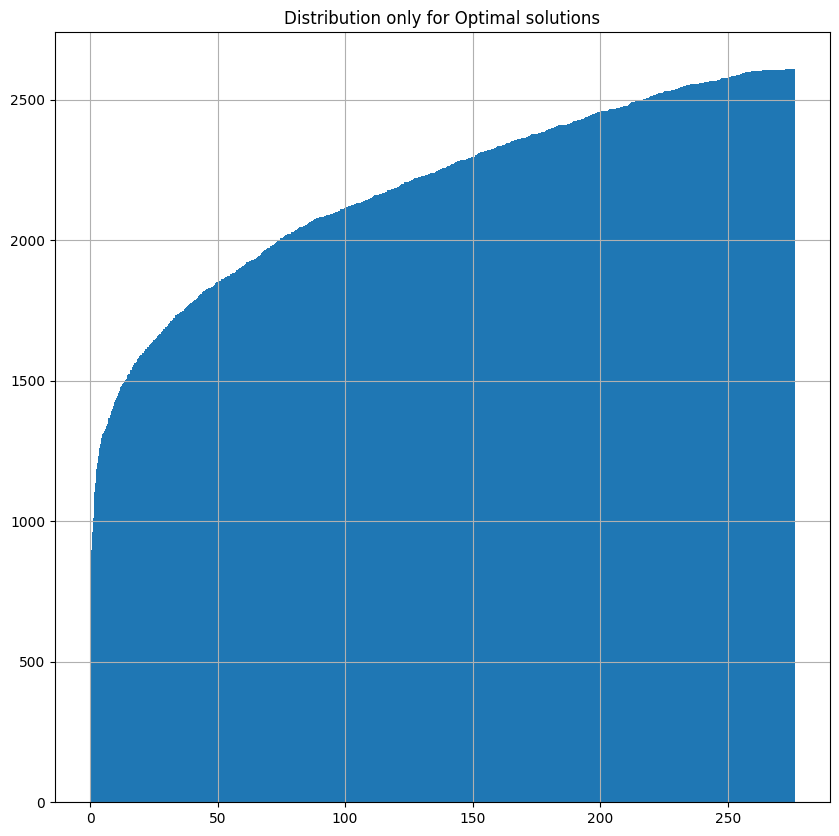

In [31]:
plt.figure(figsize=(10, 10))
plt.title("Distribution only for Optimal solutions")
vbs = df.query("status == 'Optimal solution'").sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

# Solve Time

### Components

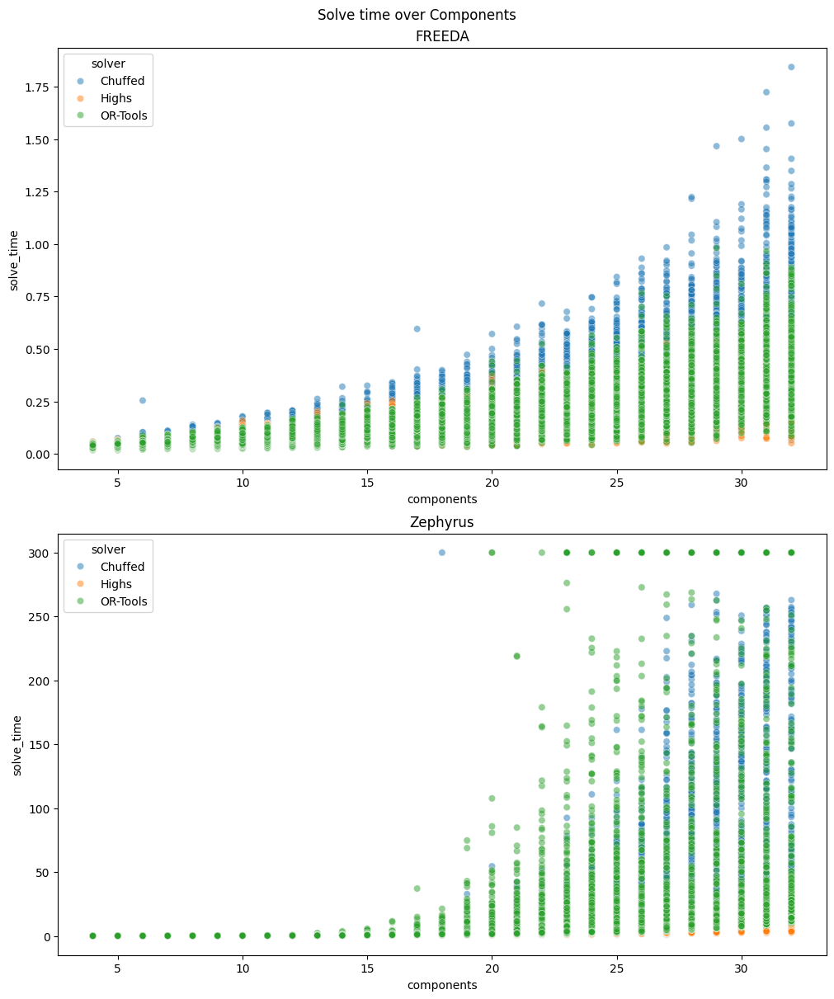

In [32]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

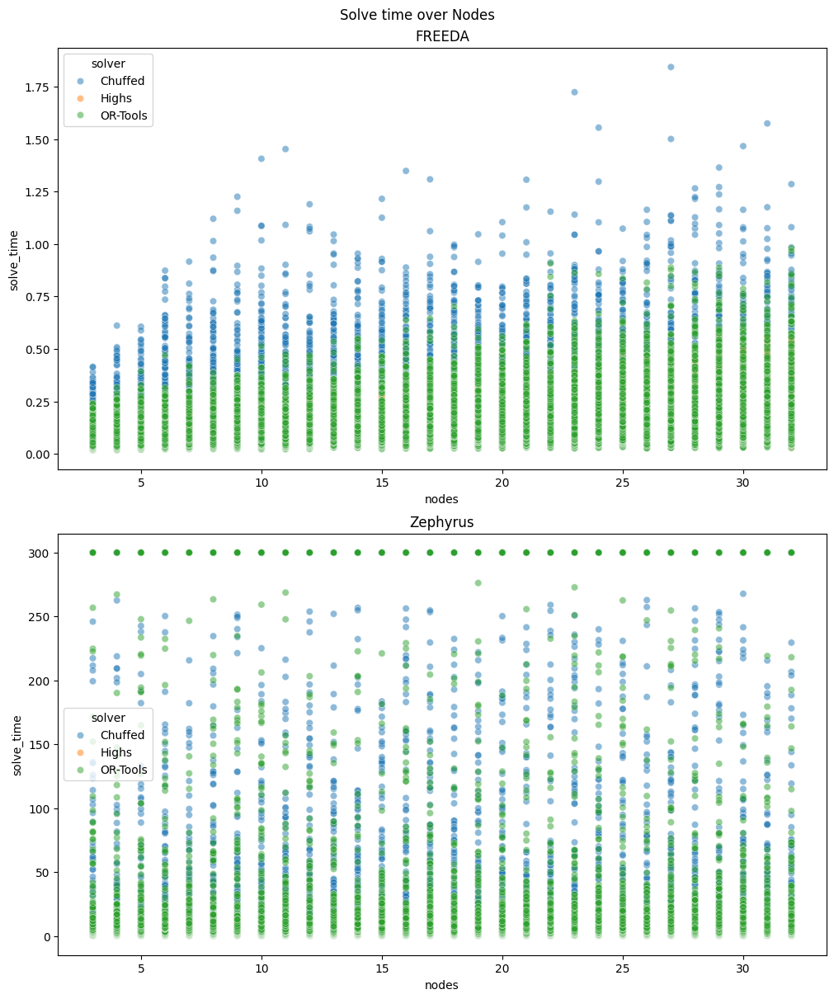

In [33]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

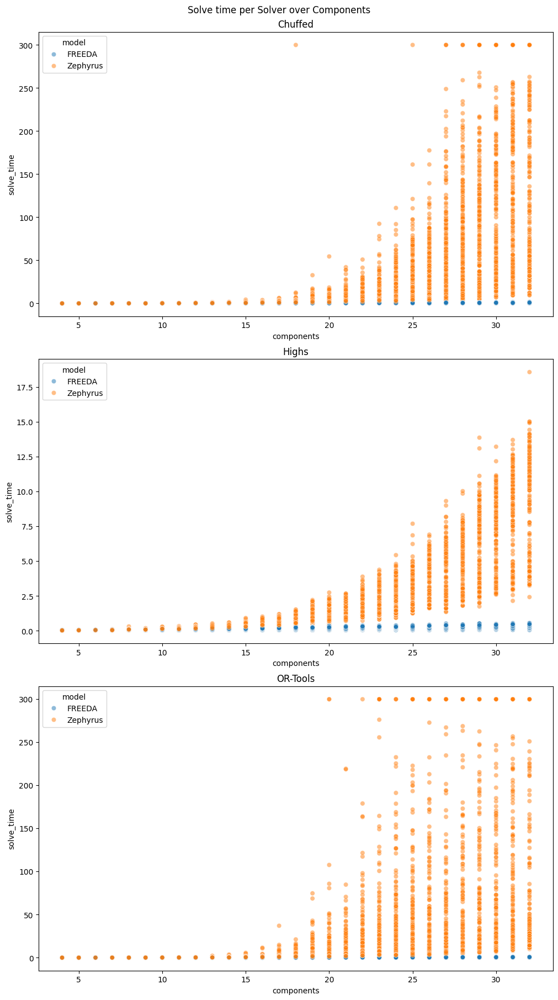

In [34]:
fig, axs = plt.subplots(len(solvers), 1, constrained_layout=True)
fig.suptitle("Solve time per Solver over Components")
fig.set_figheight(6 * len(solvers))
fig.set_figwidth(10)
for s, ax in zip(solvers, axs):
    ax.set_title(str(s))
    sns.scatterplot(
        data=df.query("solver == @s"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="model",
        ax=ax
    )

### Components x nodes

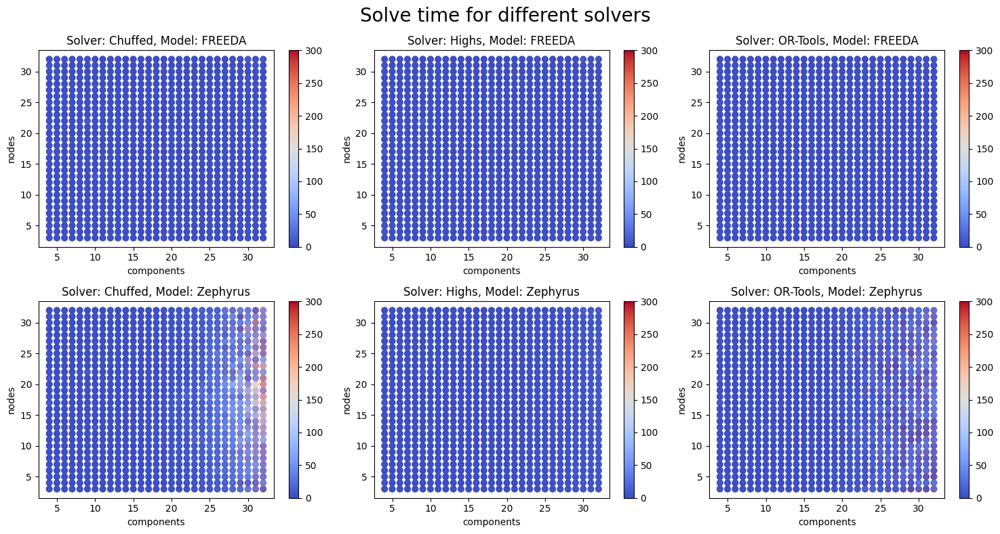

In [35]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(5 * len(solvers), 4 * len(models))
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)
        fig.colorbar(ScalarMappable(norm=norm, cmap="coolwarm"), ax=ax, orientation='vertical')

fig.suptitle("Solve time for different solvers", fontsize=20)
fig.tight_layout()

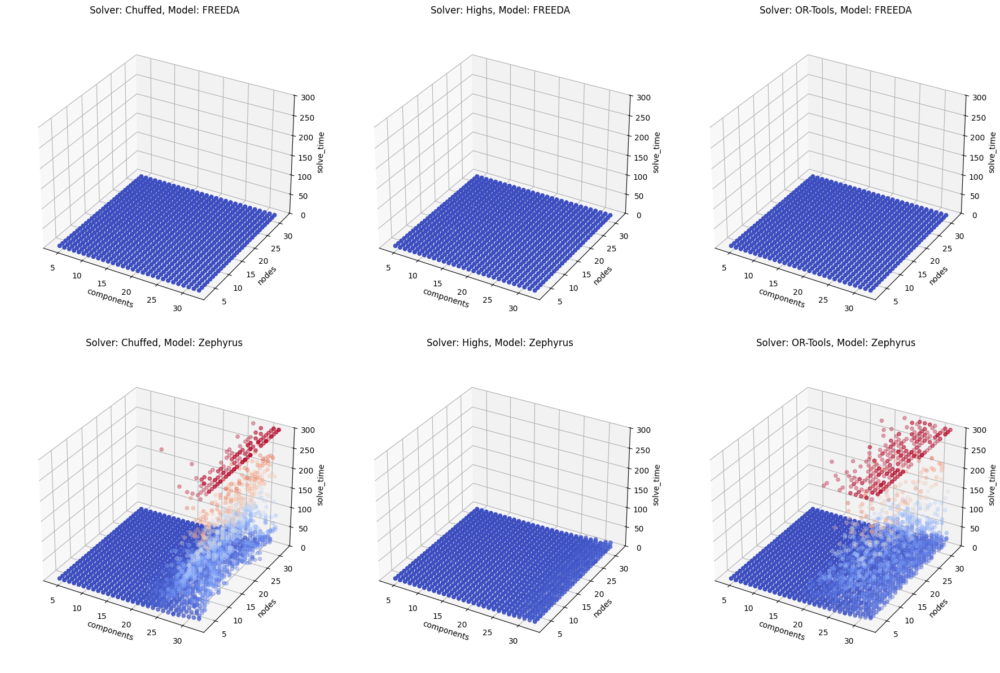

In [36]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_zlabel("solve_time")
        ax.set_title("Solver: " + s + ", Model: " + m)
        ax.set_box_aspect(None, zoom=0.90)
        ax.set_zlim([0, 300])

fig.tight_layout()

### Topologies

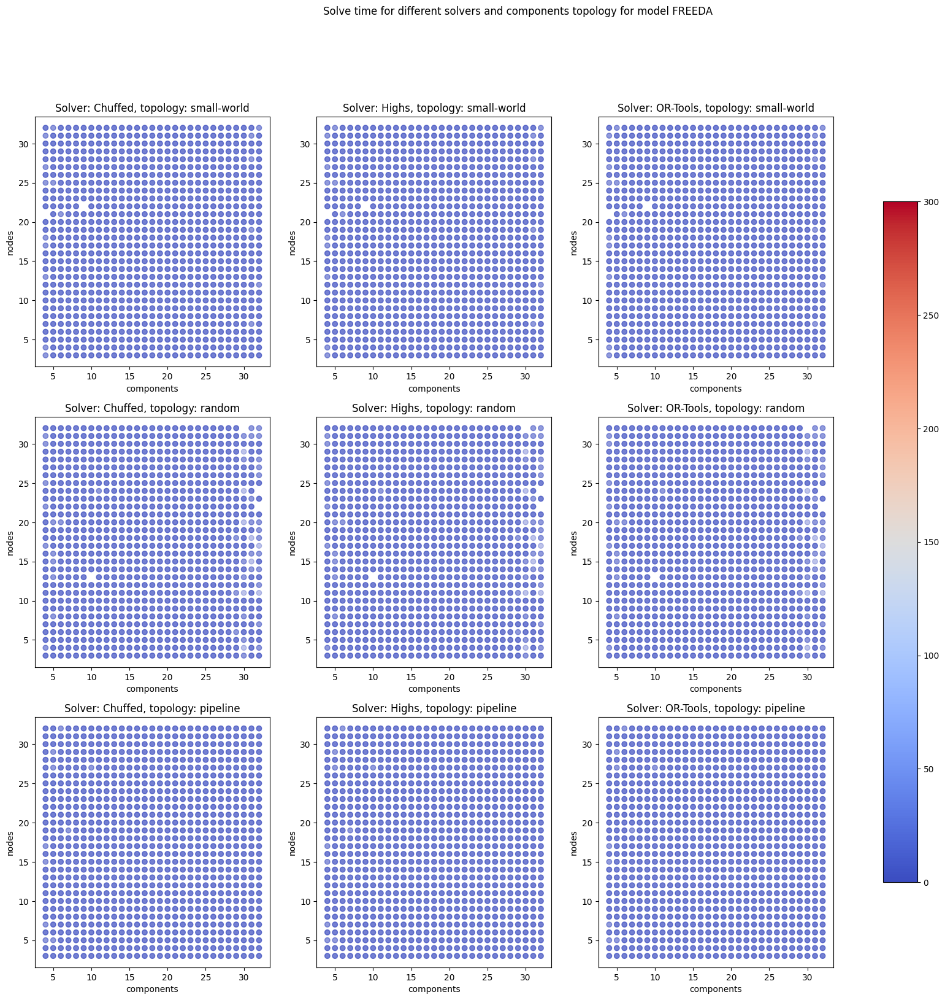

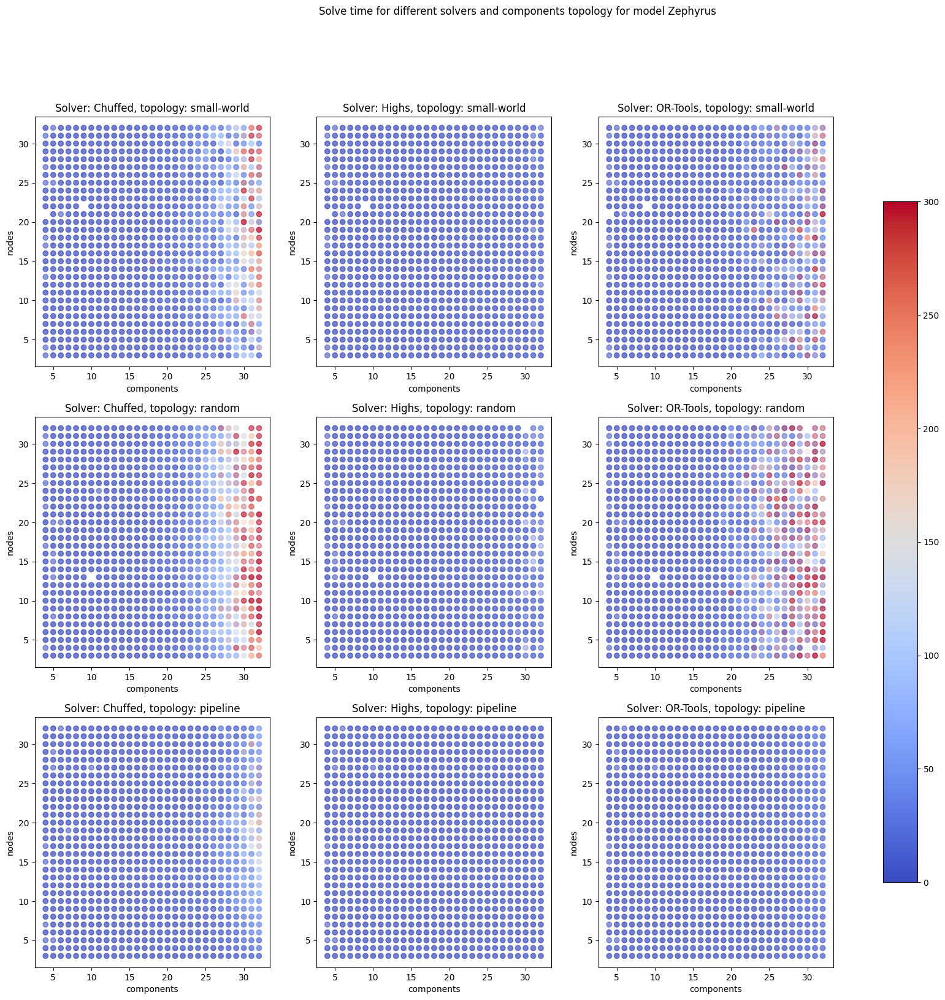

In [37]:
norm = Normalize(vmin=0, vmax=300)
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_model = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_model.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Solve time for different solvers and components topology for model " + m)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

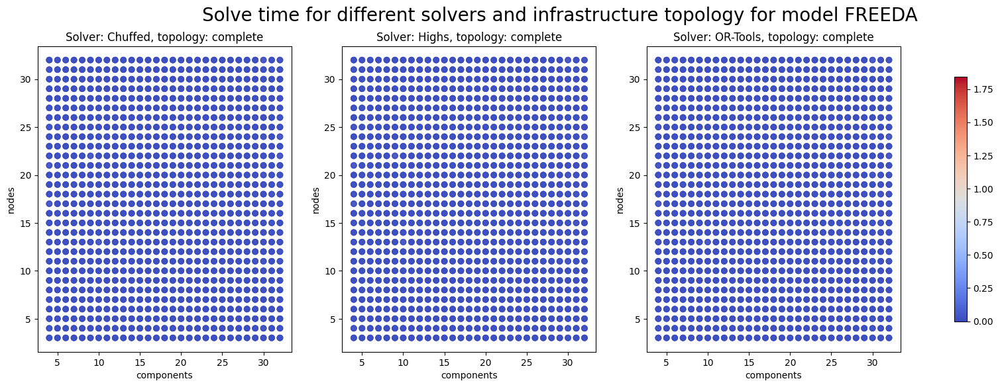

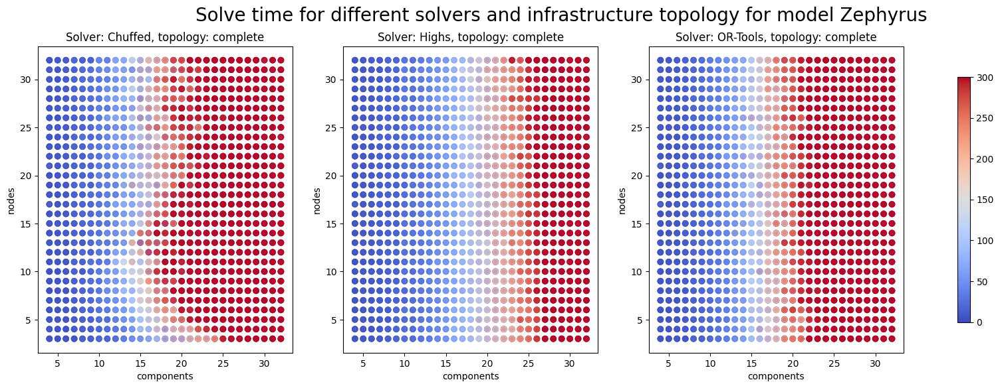

In [38]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(infrastructure_topologies),
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6 * len(infrastructure_topologies))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(infrastructure_topologies, solvers)
    df_model = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_model.query("solver == @solver").query("infra_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/len(d.test.unique())
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    norm = Normalize(vmin=0, vmax=df_model.solve_time.max())
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Solve time for different solvers and infrastructure topology for model " + m, fontsize=20)

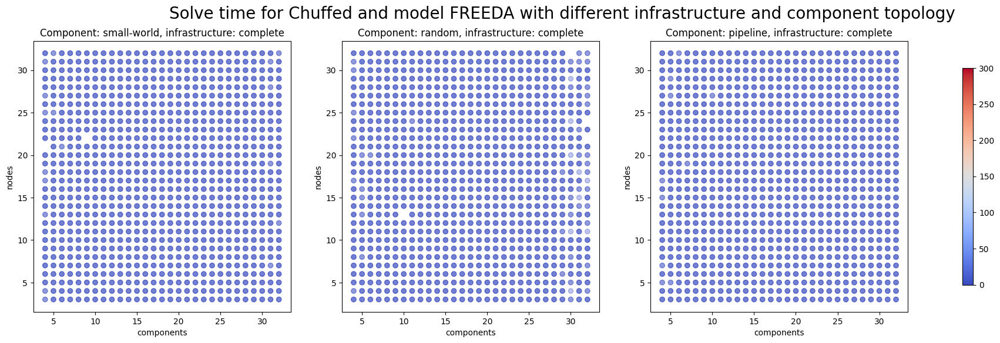

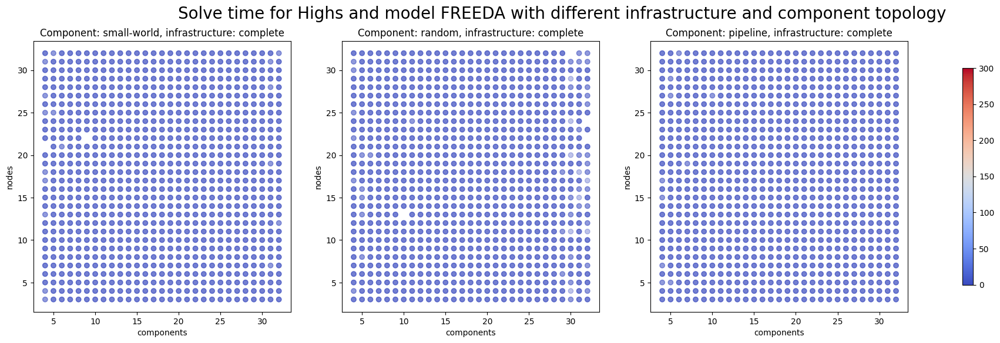

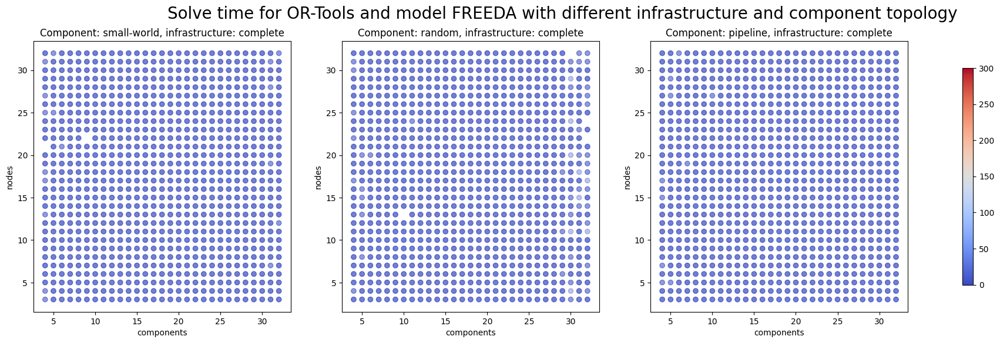

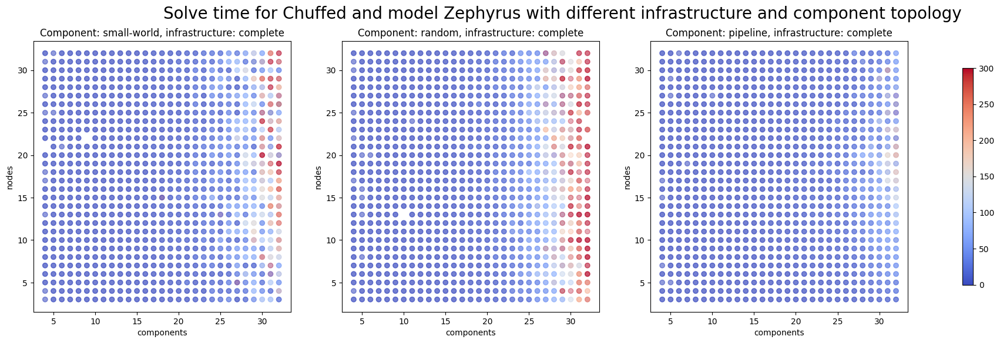

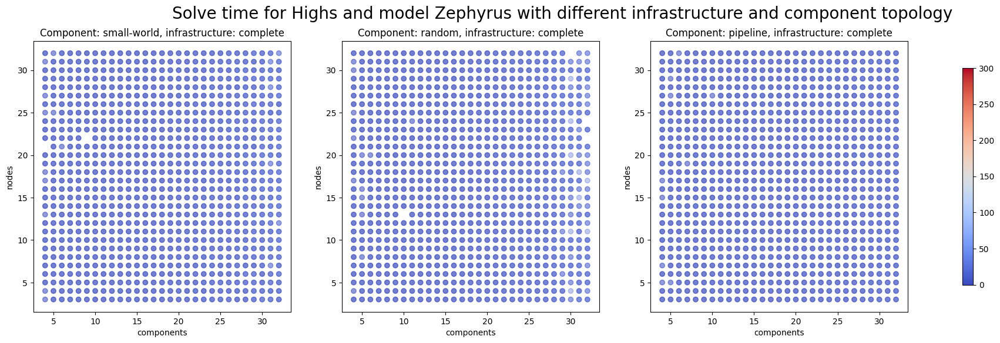

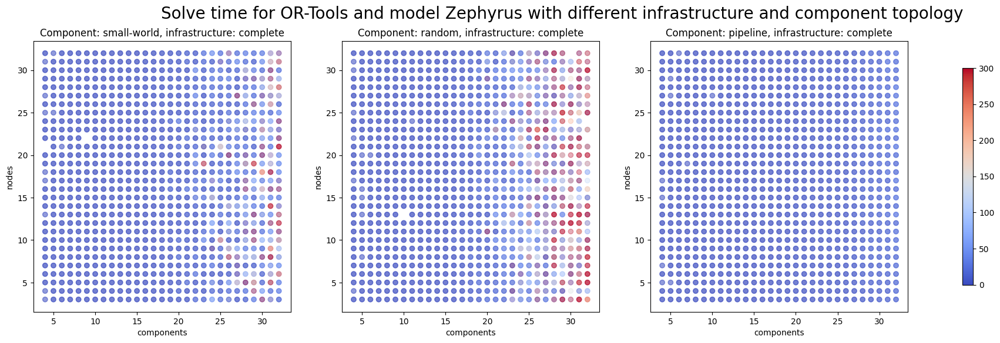

In [39]:
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m in models:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=len(infrastructure_topologies),
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6 * len(infrastructure_topologies))
        )
        axs_reshaped = axs.reshape(-1)
        axis = itertools.product(infrastructure_topologies, component_topologies)
        df_solver_problem = df.query("model == @m").query("solver == @solver")
        for (infra_topology, comps_topology), ax in zip(axis, axs_reshaped):
            d = df_solver_problem.query("infra_topology == @infra_topology").query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.solve_time,
                cmap="coolwarm",
                norm=norm,
                alpha=1.0/len(d.test.unique())
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology + ", infrastructure: " + infra_topology)

        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Solve time for " + solver + " and model " + m + " with different infrastructure and component topology", fontsize=20)


# Flat time

### Components

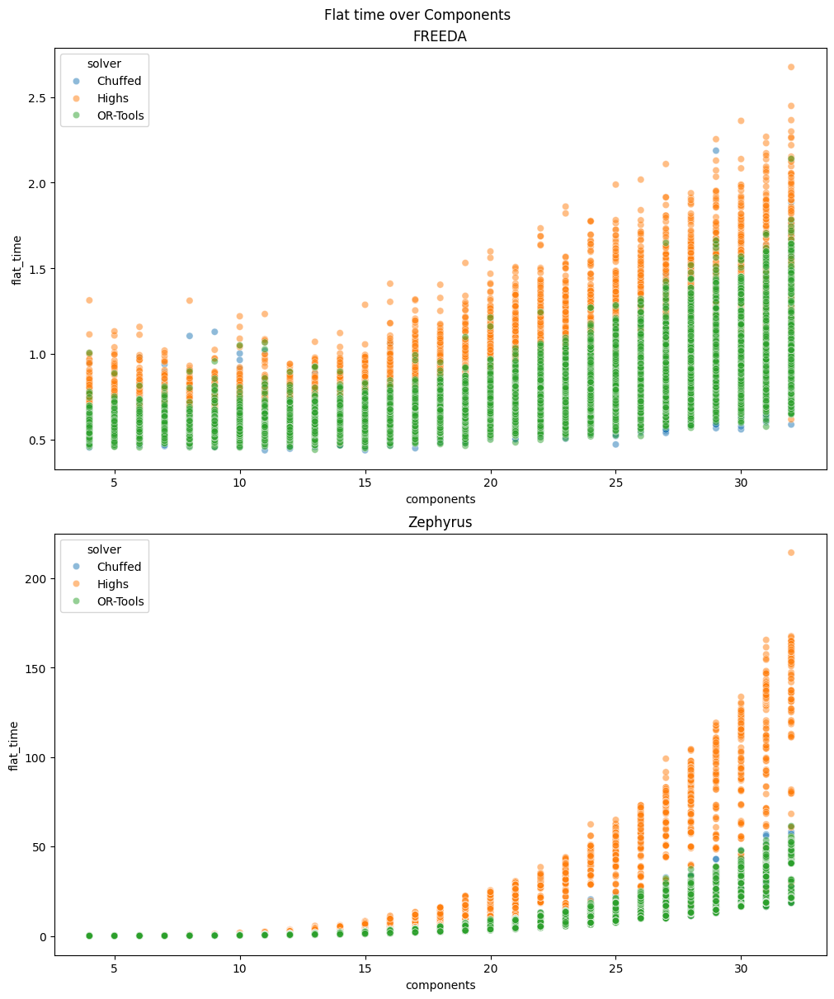

In [40]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

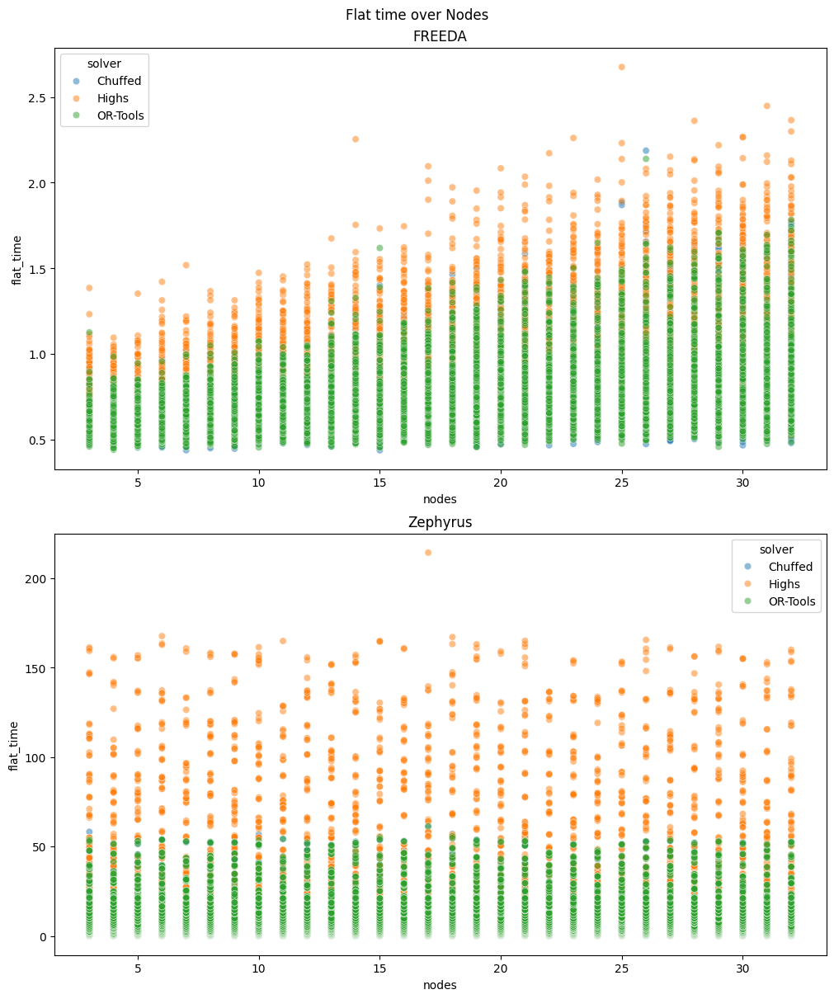

In [41]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Components x nodes

Text(0.5, 0.98, 'Flat time for different solvers')

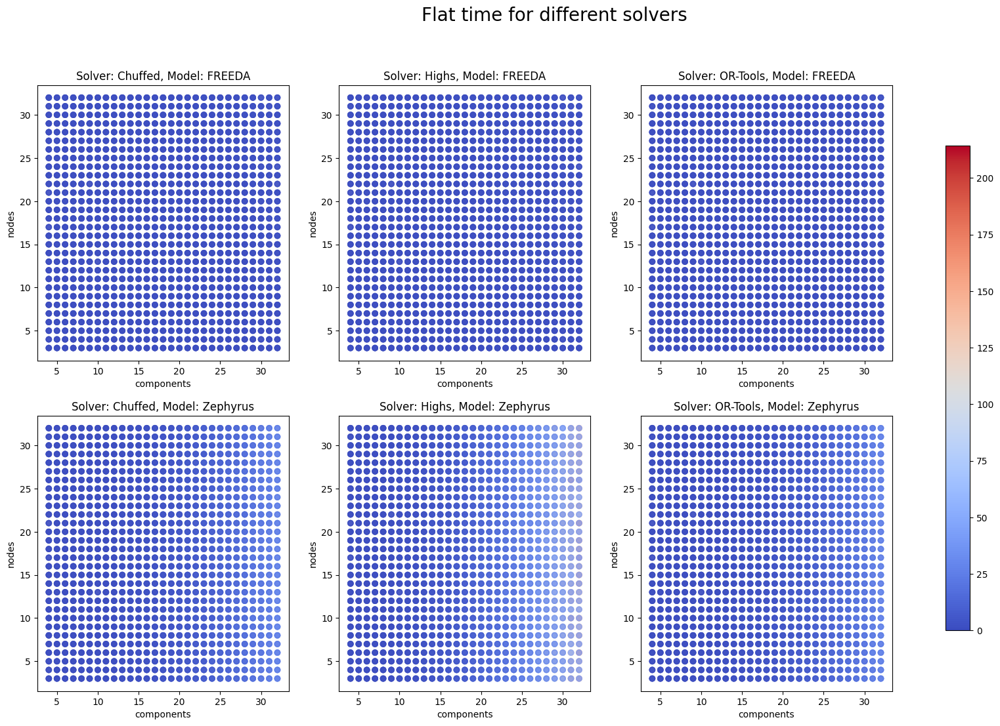

In [42]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)

fig.colorbar(
    ScalarMappable(norm=norm, cmap="coolwarm"),
    ax=axs.ravel().tolist(),
    orientation='vertical',
    shrink=0.8
)
fig.suptitle("Flat time for different solvers", fontsize=20)

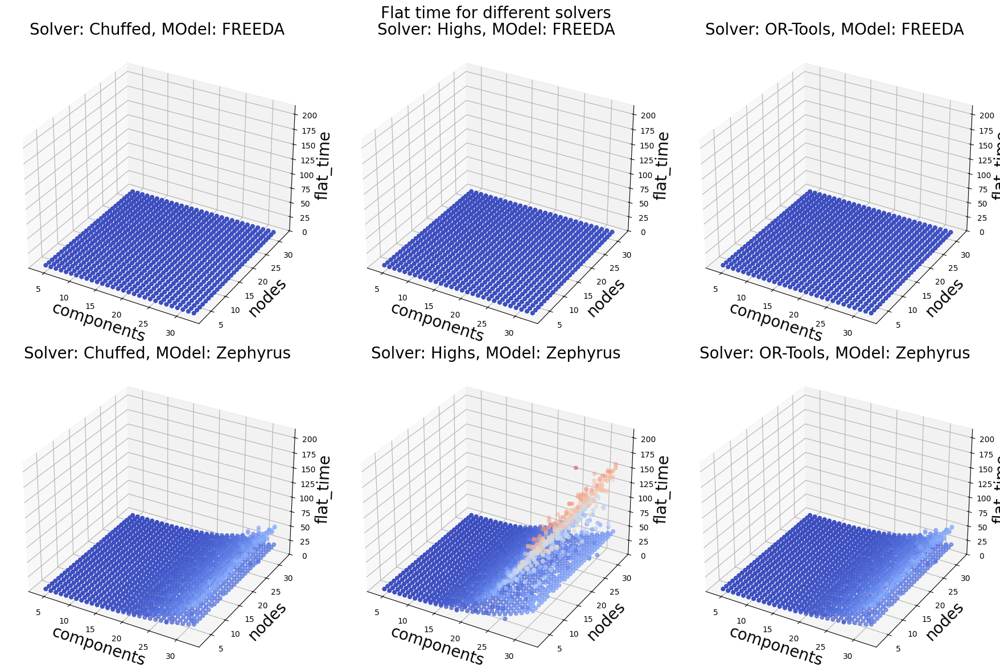

In [43]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.flat_time,
            c=d.flat_time,
            norm=norm,
            cmap="coolwarm",
            alpha=alpha
        )
        ax.set_zlim([0, df.flat_time.max()])
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("flat_time", fontsize=20)
        ax.set_title("Solver: " + s + ", MOdel: " + m, fontsize=20)

fig.suptitle("Flat time for different solvers", fontsize=20)
fig.tight_layout()

### Topologies

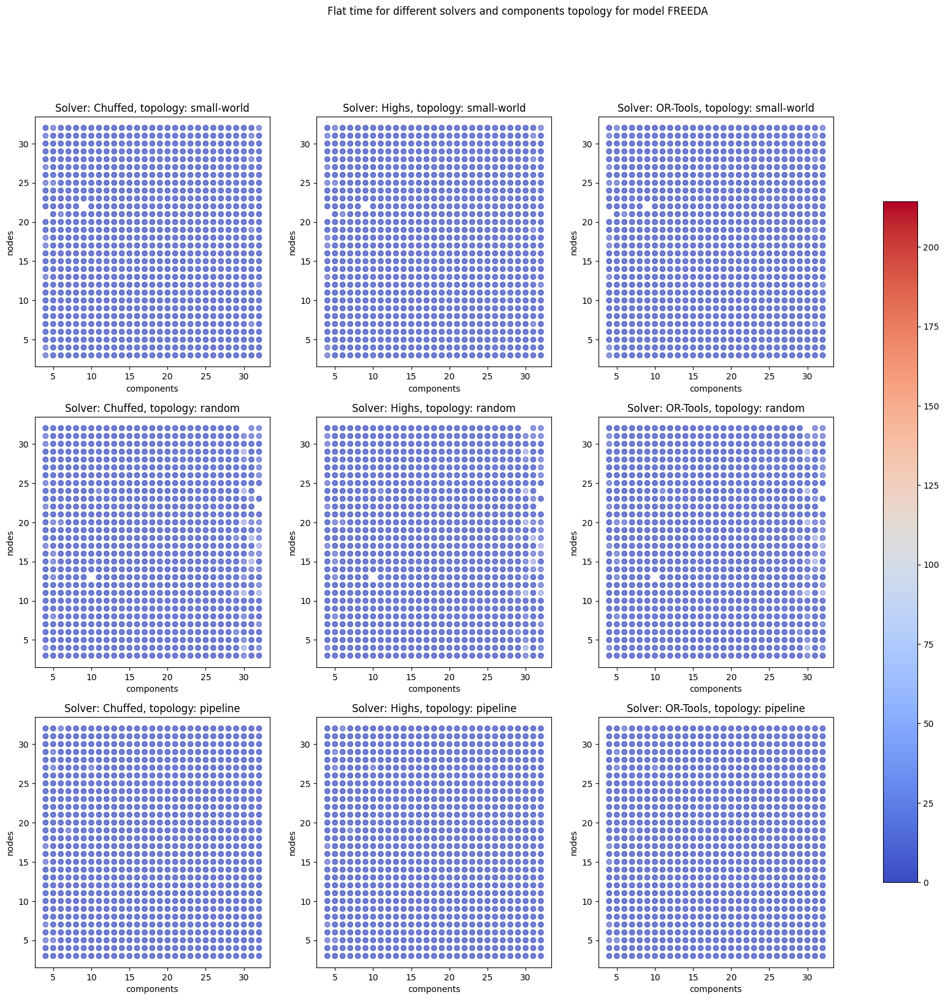

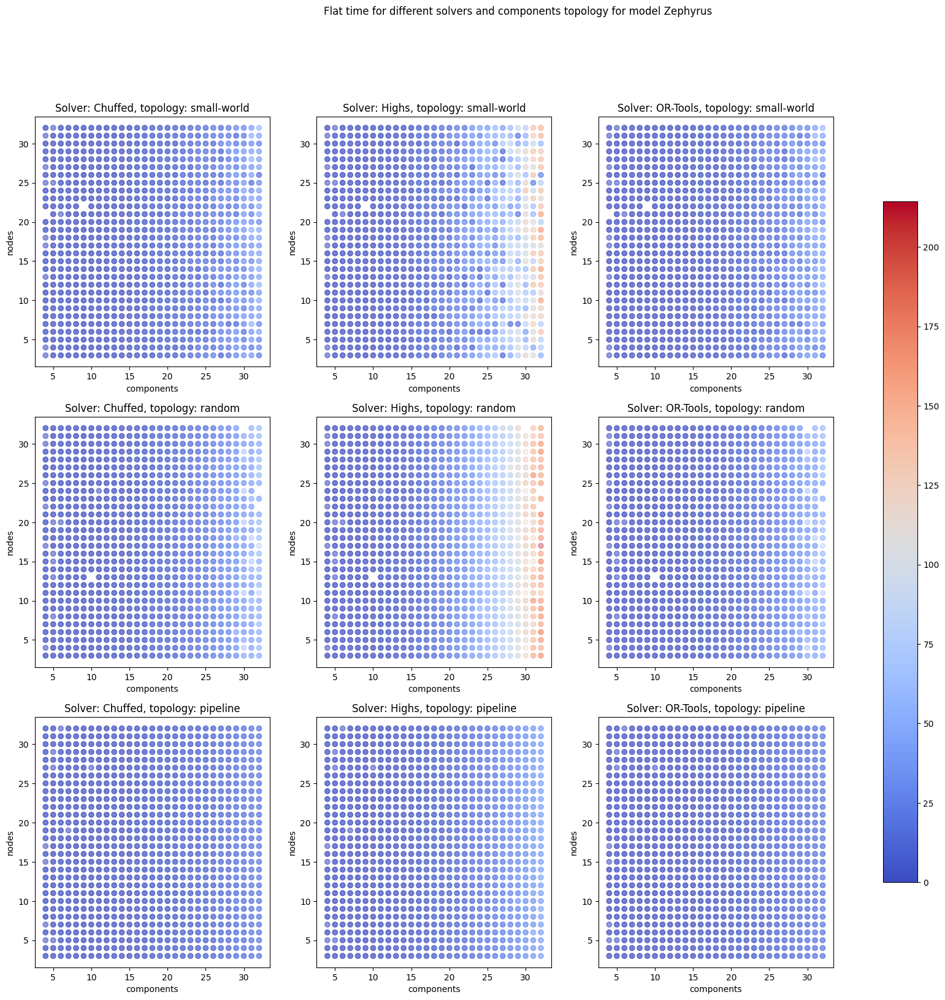

In [44]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_problem = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Flat time for different solvers and components topology for model " + m)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

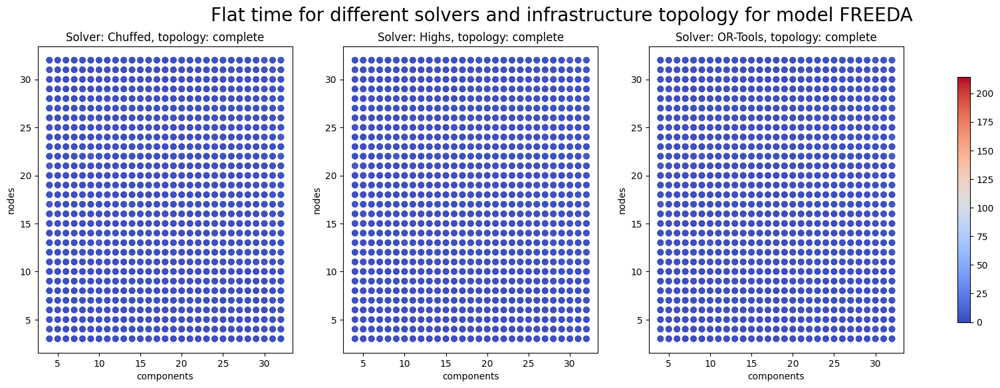

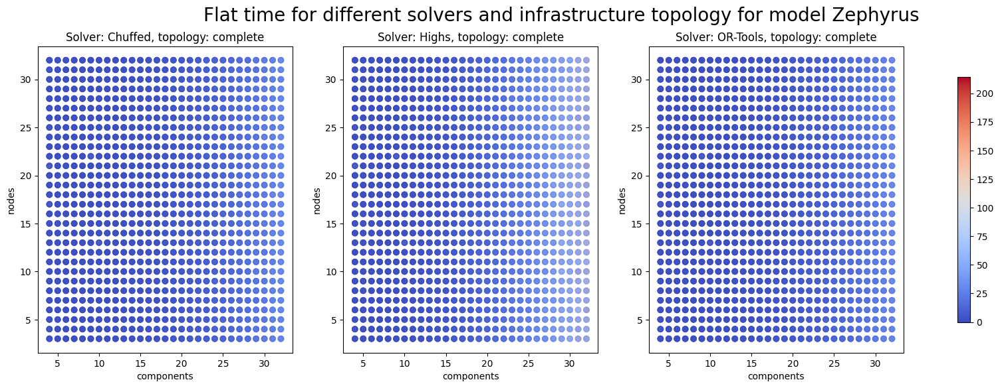

In [45]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(infrastructure_topologies),
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6 * len(infrastructure_topologies))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(infrastructure_topologies, solvers)
    df_problem = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("infra_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=alpha
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Flat time for different solvers and infrastructure topology for model " + m, fontsize=20)

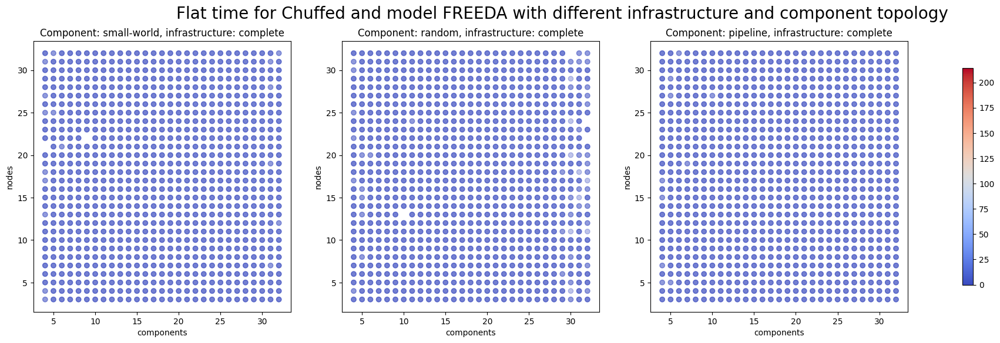

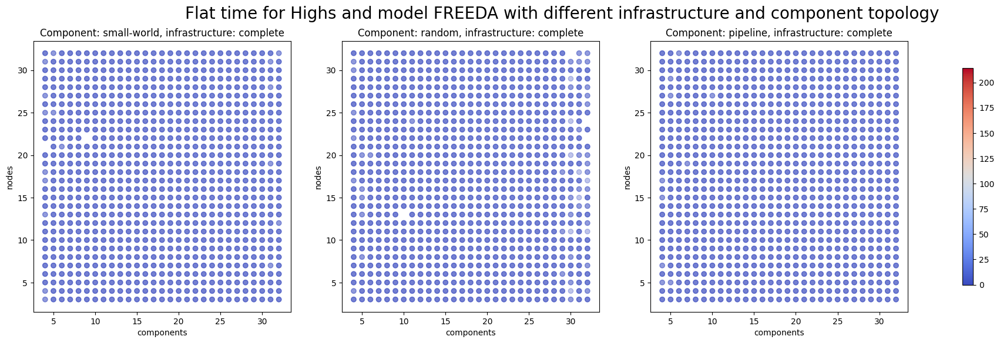

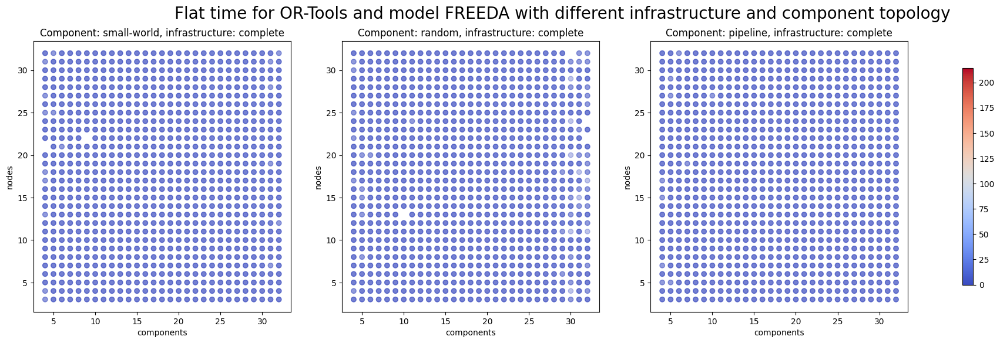

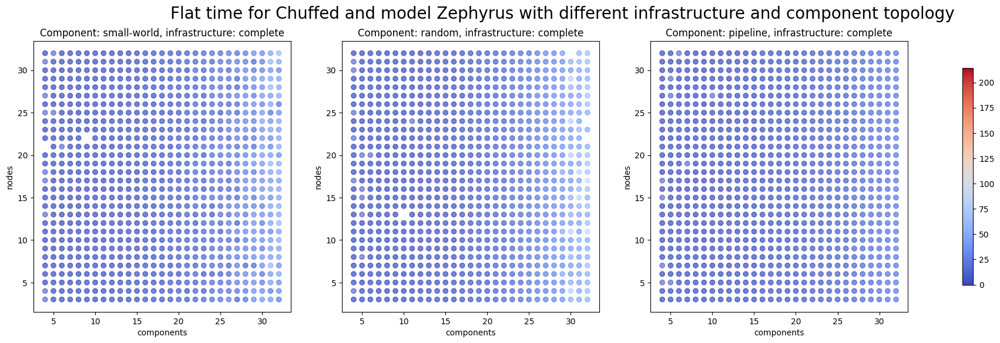

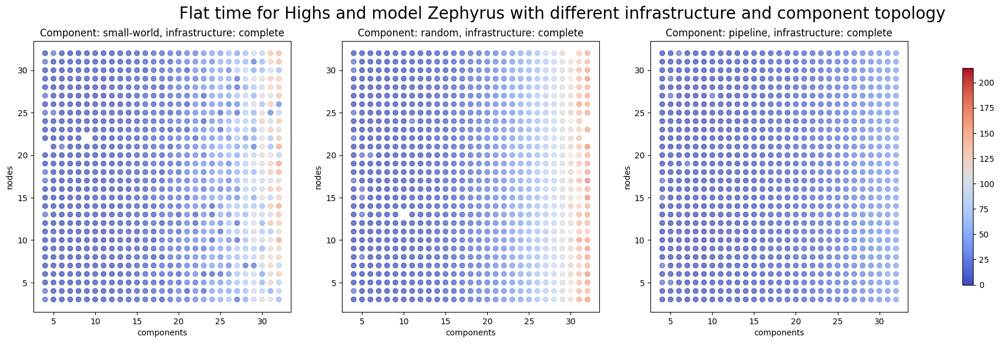

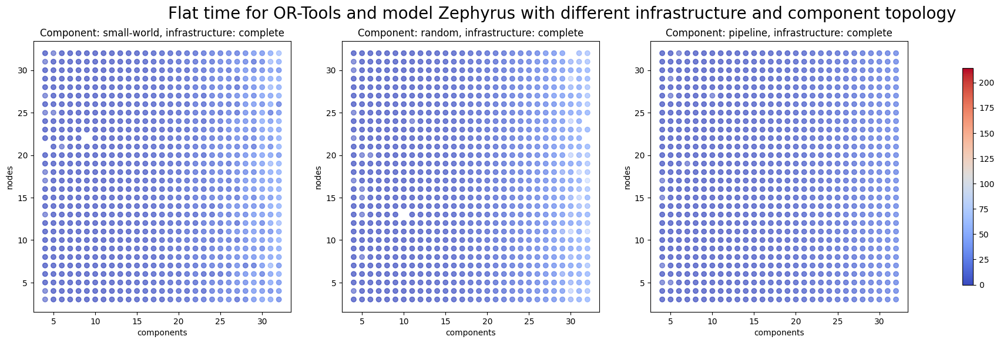

In [46]:
for m in models:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=len(infrastructure_topologies),
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6 * len(infrastructure_topologies))
        )
        axs_reshaped = axs.reshape(-1)
        axis = itertools.product(infrastructure_topologies, component_topologies)
        df_solver_problem = df.query("model == @m").query("solver == @solver")
        for (infra_topology, comps_topology), ax in zip(axis, axs_reshaped):
            d = df_solver_problem.query("infra_topology == @infra_topology").query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.flat_time,
                cmap="coolwarm",
                norm=norm,
                alpha=alpha
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology + ", infrastructure: " + infra_topology)

        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Flat time for " + solver + " and model " + m + " with different infrastructure and component topology", fontsize=20)


# Flat time vs Solve time

In [47]:
ax.get_ylim()[1]

np.float64(33.45)

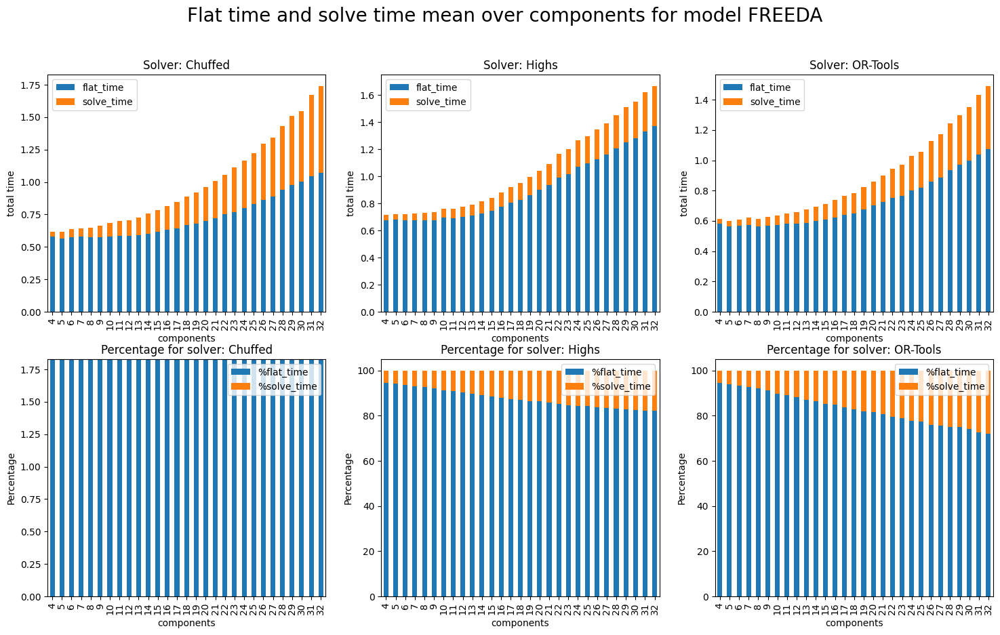

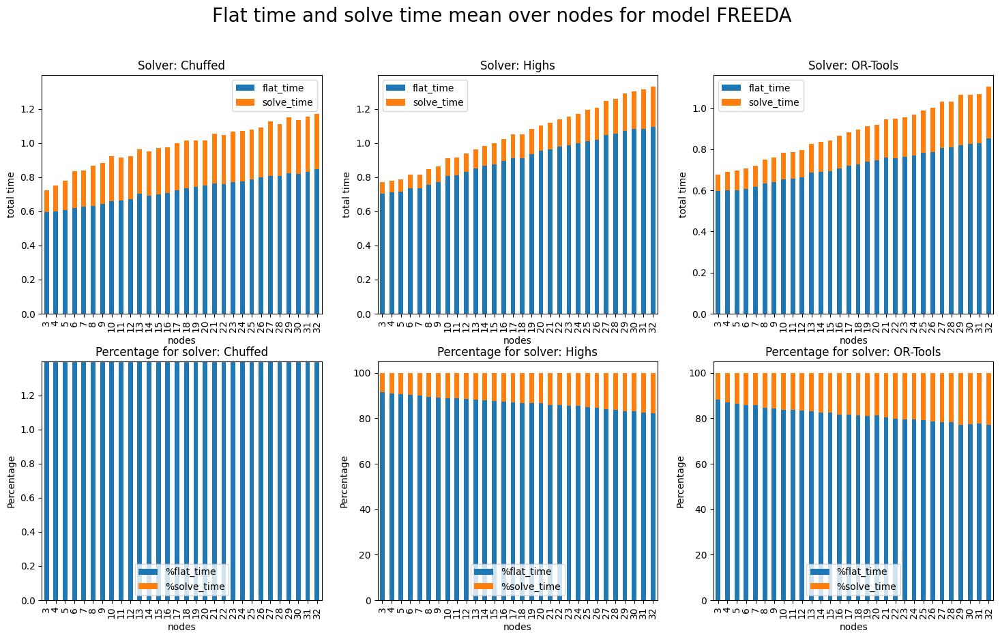

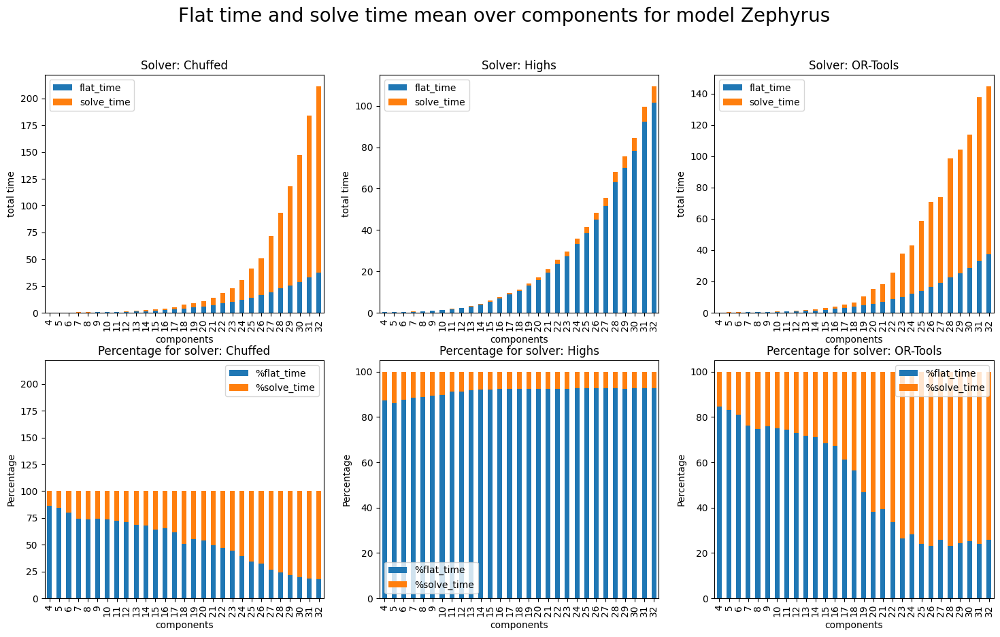

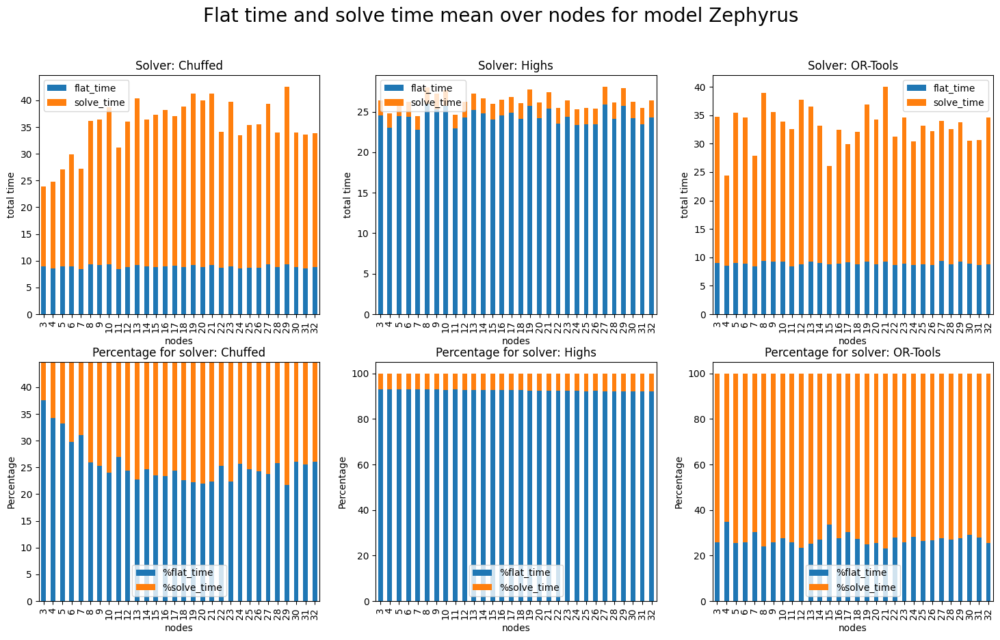

In [48]:
for m in models:
    for over in ["components", "nodes"]:
        fig, axs = plt.subplots(
            nrows=2,
            ncols=len(solvers),
            figsize=(6 * len(solvers), 10)
        )
        axs_reshaped = axs.reshape(-1)

        mx = 0
        for solver, (i, ax) in zip(solvers, enumerate(axs_reshaped)):
            times = (
                df
                .query("solver == @solver")
                .query("model == @m")
                .groupby(over)
                [["flat_time", "solve_time"]]
                .mean()
            )

            times.plot.bar(
                ax=ax,
                stacked=True,
                title="Solver: " + solver,
            )
            ax.set_ylabel("total time")

            times.assign(**{
                "%flat_time" : lambda df : df["flat_time"] / (df["solve_time"] + df["flat_time"]) * 100,
                "%solve_time" : lambda df : df["solve_time"] / (df["solve_time"] + df["flat_time"]) * 100
            }).drop(
                columns=["solve_time", "flat_time"]
            ).plot.bar(
                stacked=True,
                title="Percentage for solver: " + solver,
                ax=axs_reshaped[len(solvers) + i],
            )
            mx = max(mx, ax.get_ylim()[1])
            axs_reshaped[len(solvers) + i].set_ylabel("Percentage")

        fig.suptitle("Flat time and solve time mean over " + over + " for model " + m, fontsize=20)
        [ax[0].set_ylim([0, mx]) for ax in axs]
        plt.show()


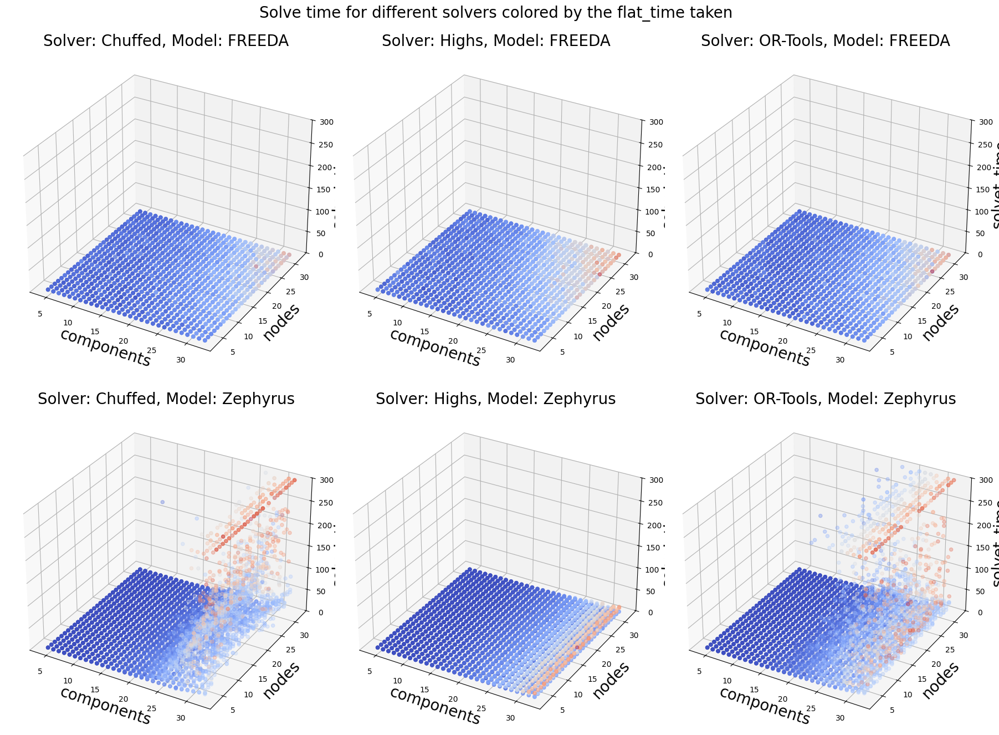

In [49]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 7 * len(models)),
    subplot_kw=dict(projection='3d')
)
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.flat_time,
            cmap="coolwarm",
            alpha=alpha
        )
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("solvet_time", fontsize=20)
        ax.set_title("Solver: " + s + ", Model: " + m, fontsize=20)
        ax.set_zlim([0, df.solve_time.max()])

fig.suptitle("Solve time for different solvers colored by the flat_time taken", fontsize=20)
fig.tight_layout()

/var/folders/0c/_45bz49544131ywq145p6vn00000gn/T/ipykernel_69184/3900797237.py:23: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  [ax.set_ylim([0, mx]) for row in axs for ax in row]


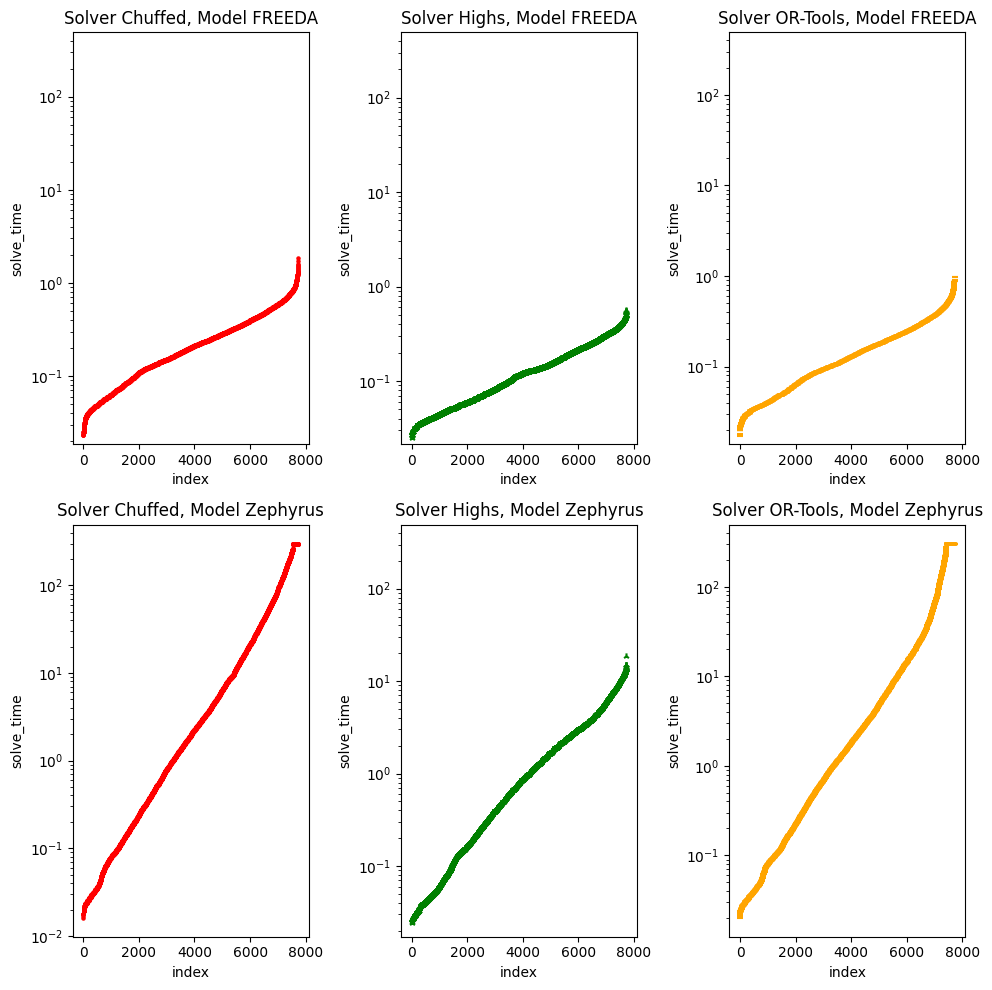

In [50]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(10, 10),
)

mx = 0
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s").solve_time.sort_values(ascending=True).reset_index(drop=True).reset_index()
        d.plot.scatter(
            x="index",
            y="solve_time",
            ax=ax,
            c=color[s],
            marker=marker[s]
        )

        ax.set_title("Solver " + s + ", Model " + m)
        ax.set_yscale('log')
        mx = max(mx, ax.get_ylim()[1])

[ax.set_ylim([0, mx]) for row in axs for ax in row]

fig.tight_layout()

# Paper images and tables

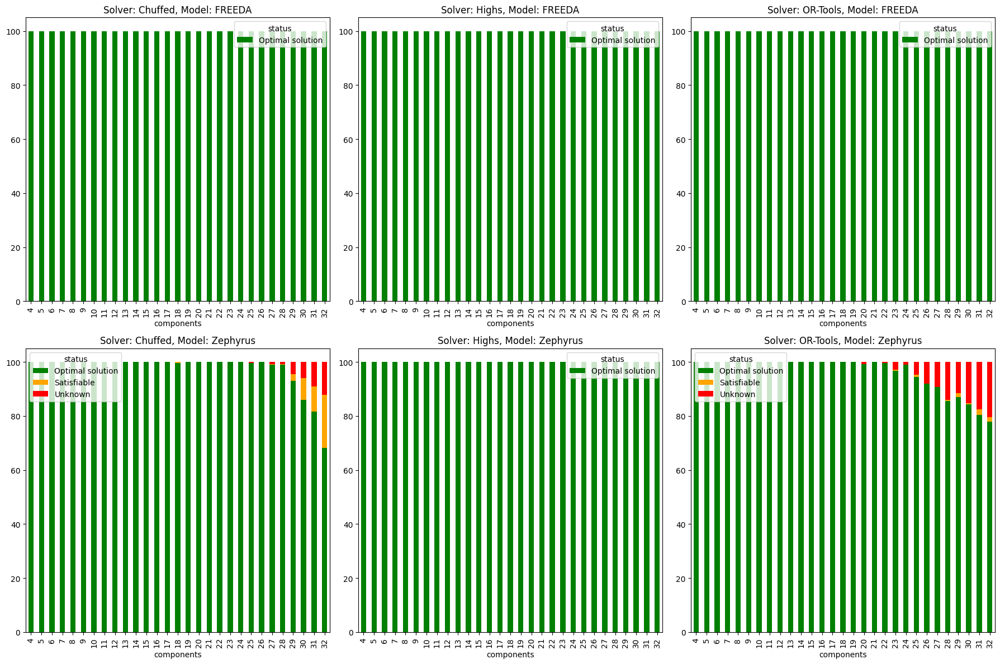

In [51]:
colors = {
    "Optimal solution": "green",
    "Unsatisfiable": "#1f77b4",
    "Unknown": "red",
    "Satisfiable" : "orange"
}
fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    figsize=(6 * len(solvers), 12)
)
norm = Normalize(vmin=0, vmax=100)
for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            [["components", "status"]]
            .groupby("components")
            .value_counts(normalize=True)
            * 100
        ).reset_index().pivot(
            index="components",
            columns="status",
            values="proportion"
        ).fillna(0)

        d.plot.bar(
            color=colors,
            stacked=True,
            ax=ax,
            title="Solver: " + solver + ", Model: " + model
        )

fig.tight_layout()
plt.show()

Text(0, 0.5, 'solve time difference')

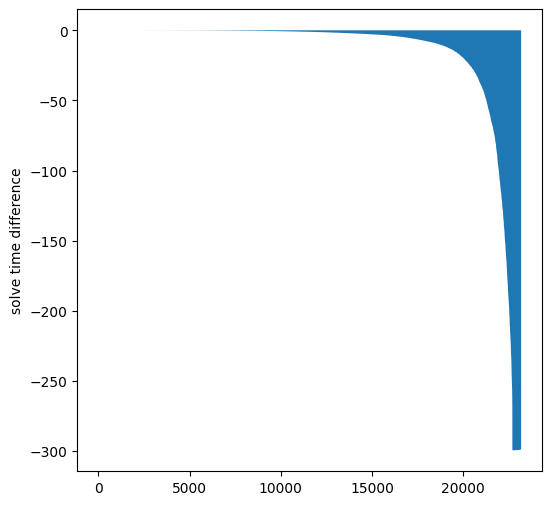

In [52]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

area_plot = (
    df.query("model == 'FREEDA'").solve_time.sort_values().reset_index(drop=True)
    -
    df.query("model == 'Zephyrus'").solve_time.sort_values().reset_index(drop=True)
).reset_index()

ax.fill_between(area_plot.index, area_plot.solve_time)
ax.set_xlabel("")
ax.set_ylabel("solve time difference")

In [53]:
save_fig(fig, "solve-time-diff-zeph")

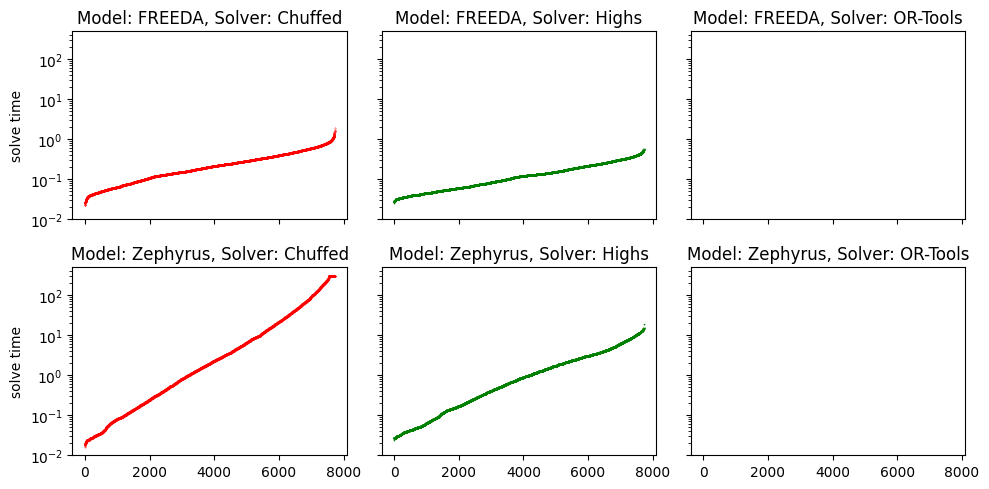

In [54]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    sharex=True,
    sharey=True,
    figsize=(10, 5),
)

for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        (
            df.query("solver == @solver")
            .query("model == @model")
            .solve_time
            .sort_values(ascending=True)
            .reset_index(drop=True).reset_index()
            .plot.scatter(
                x="index",
                y="solve_time",
                s=0.3,
                ax=ax,
                marker=marker[solver],
                c=color[solver]
            )
        )
        ax.set_title("Model: " + model + ", Solver: " + solver)
        ax.set_yscale('log')
        ax.set_ylabel("solve time")
        ax.set_xlabel("")

fig.tight_layout()

In [55]:
save_fig(fig, "solve-time-log-zeph")

In [56]:
mean_solve_time = (
    df[["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "Mean Solve Time"})
    #.unstack()
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_solve_time

Mean Solve Time
model    solver                  
FREEDA   Chuffed            0.27s
         Highs              0.14s
         OR-Tools           0.17s
Zephyrus Chuffed           26.36s
         Highs              1.96s
         OR-Tools          24.27s

In [57]:
std_solve_time = (
    df[["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("std")
    .rename(columns={"solve_time" : "St. Dev. Solve Time"})
    #.unstack()
    .map(lambda x : str(round(x, 2)) + "s")
)
std_solve_time

St. Dev. Solve Time
model    solver                      
FREEDA   Chuffed                0.22s
         Highs                   0.1s
         OR-Tools               0.14s
Zephyrus Chuffed               60.64s
         Highs                   2.7s
         OR-Tools               64.1s

In [58]:
opt_perc = (
    df[["model", "solver", "status"]]
    .groupby(["model", "solver"])
    .aggregate(lambda x : str(round((len(x[x.str.contains("Optimal solution")]) / len(x)) * 100, 2)) + "%")
    .rename(columns={"status" : "Optimality"})
    #.unstack()
)
opt_perc

Optimality
model    solver             
FREEDA   Chuffed      100.0%
         Highs        100.0%
         OR-Tools     100.0%
Zephyrus Chuffed      97.58%
         Highs        100.0%
         OR-Tools     96.19%

In [59]:
scores = []
errors = []

df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["model", "solver", "flavours", "resources", "flat_time", "infra_topology", "optimal_solution"])

combinations = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

for model_solver1, model_solver2 in combinations:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        if len(group) == 2: # Make sure that if an instance failed to run, this code will run anyway
            scores.append(group.assign(Score=borda_count))

In [60]:
s = (
    pd.concat(scores)
    [["model_solver", "Score"]]
    .groupby("model_solver")
    .sum()
    .reset_index()
    .assign(**{
        "model" : lambda df : df.apply(lambda x : x.model_solver.split("_")[0], axis=1),
        "solver" : lambda df : df.apply(lambda x : x.model_solver.split("_")[1], axis=1)
    })
    .drop(columns=["model_solver"])
    [["model", "solver", "Score"]]
    .sort_values("Score", ascending=False)
    .groupby(["model", "solver"])
    .sum()
    .map(lambda x : "{:.2f}".format(x))
)

In [61]:
print(
    pd.concat([
        mean_solve_time,
        std_solve_time,
        opt_perc,
        s
    ], axis=1)
    .sort_values("Score", ascending=False)
    .to_latex(multirow=False, escape=True)
)

\begin{tabular}{llllll}
\toprule
 &  & Mean Solve Time & St. Dev. Solve Time & Optimality & Score \\
model & solver &  &  &  &  \\
\midrule
FREEDA & Highs & 0.14s & 0.1s & 100.0\% & 25522.50 \\
 & OR-Tools & 0.17s & 0.14s & 100.0\% & 25522.50 \\
 & Chuffed & 0.27s & 0.22s & 100.0\% & 25396.76 \\
Zephyrus & Highs & 1.96s & 2.7s & 100.0\% & 17435.66 \\
 & OR-Tools & 24.27s & 64.1s & 96.19\% & 11507.37 \\
 & Chuffed & 26.36s & 60.64s & 97.58\% & 10490.21 \\
\bottomrule
\end{tabular}



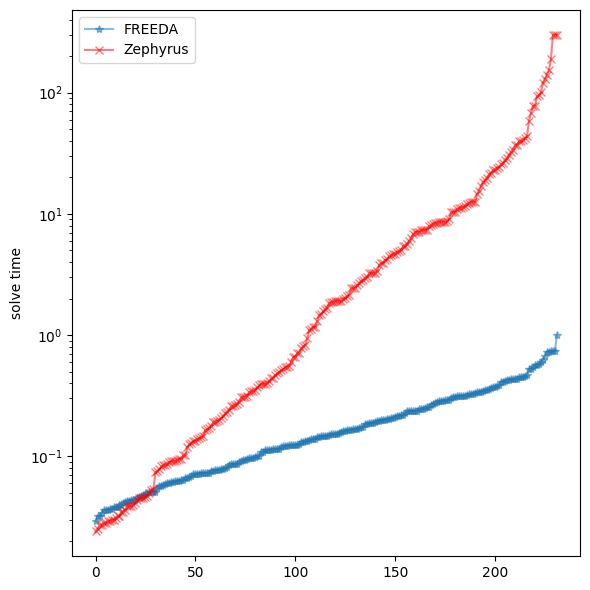

In [62]:

fig, ax = plt.subplots(
    nrows=1,
    ncols=1,
    figsize=(6, 6),
)

marker_model = {
    "FREEDA": "*",
    "Zephyrus": "x"
}
color_model = {
    "FREEDA": "#1f77b4",
    "Zephyrus": "red"
}

for model in models:
    (
        df
        .query("model == @model")
        .sample(frac=0.01)
        .solve_time
        .sort_values(ascending=True)
        .reset_index(drop=True).reset_index()
        .plot.line(
            x="index",
            y="solve_time",
            ax=ax,
            marker=marker_model[model],
            alpha=0.5,
            ms=6,
            linestyle="-",
            color=color_model[model],
            label=model
        )
    )
    ax.set_yscale('log')
    ax.set_ylabel("solve time")
    ax.set_xlabel("")

fig.tight_layout()

In [63]:
save_fig(fig, "solve-time-distrib-zeph")

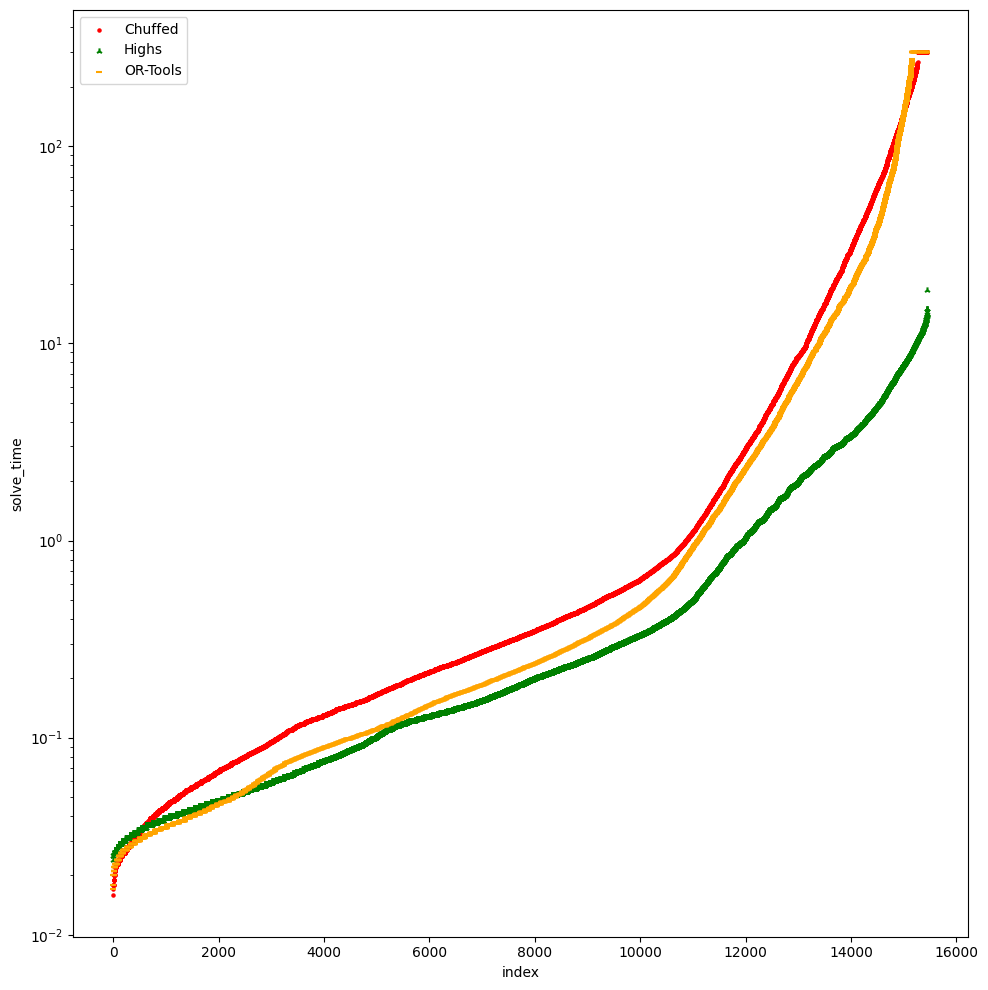

In [64]:
fig, ax = plt.subplots(
    nrows=1,
    ncols=1,
    figsize=(10, 10),
)

for solver in solvers:
    d = df.query("solver == @solver").solve_time.sort_values(ascending=True).reset_index(drop=True).reset_index()
    d.plot.scatter(x="index", y="solve_time", ax=ax, c=color[solver], marker=marker[solver], label=solver)

ax.set_yscale("log")
ax.legend()
fig.tight_layout()